# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [7]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [30]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.type(torch.float), y.type(torch.float)), dim=1)
    #### END CODE HERE ####
    return combined

In [31]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [24]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [14]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [21]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [22]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [25]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 1.997260571360588, discriminator loss: 0.3042696650363505


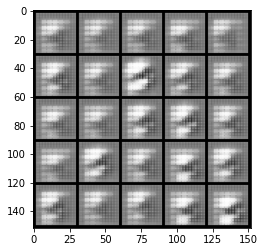

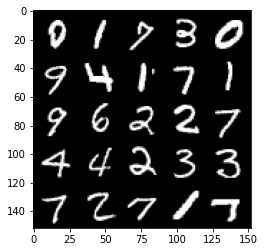

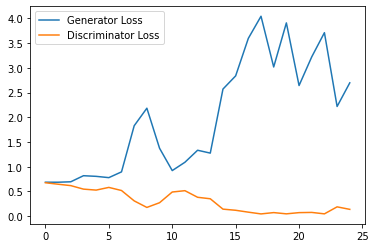

Step 1000: Generator loss: 3.827780906677246, discriminator loss: 0.09236512066423894


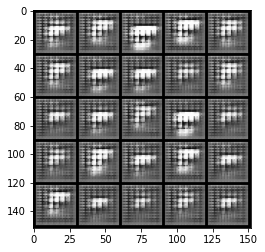

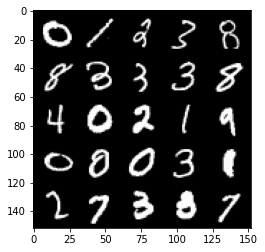

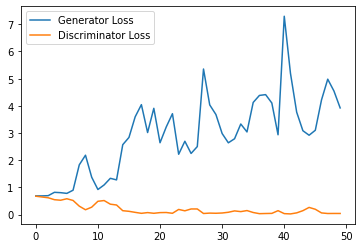

Step 1500: Generator loss: 4.474705774307251, discriminator loss: 0.04977446037530899


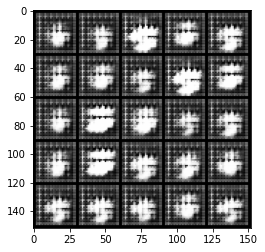

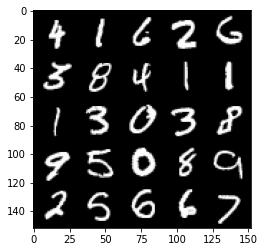

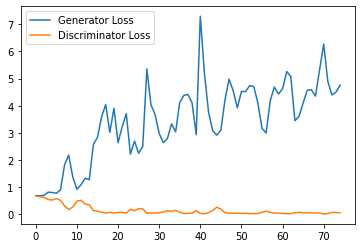

Step 2000: Generator loss: 4.28217093038559, discriminator loss: 0.05637639062106609


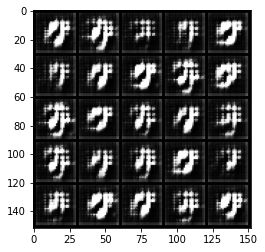

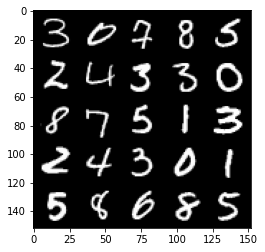

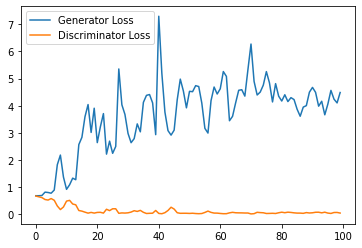

Step 2500: Generator loss: 3.8352964730262755, discriminator loss: 0.09036598663404584


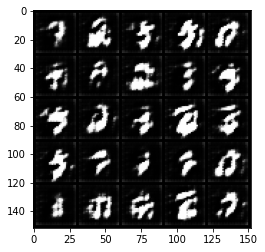

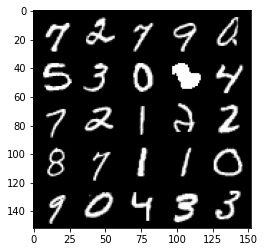

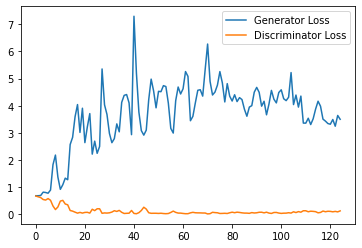

Step 3000: Generator loss: 2.968810298204422, discriminator loss: 0.22539340141415595


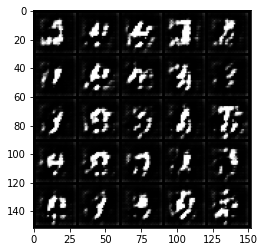

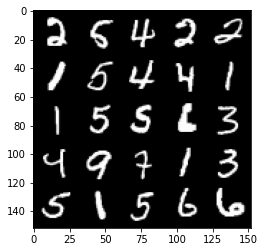

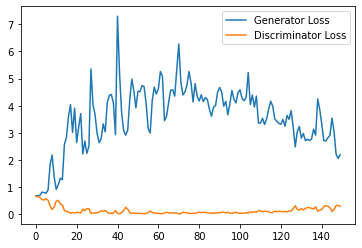

Step 3500: Generator loss: 2.306574540615082, discriminator loss: 0.2933232994377613


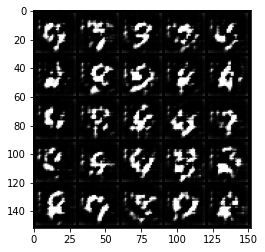

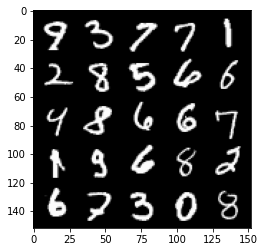

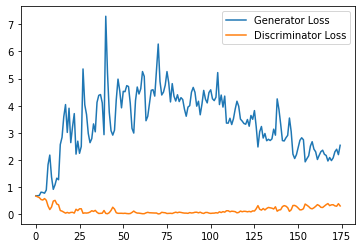

Step 4000: Generator loss: 2.1125758645534516, discriminator loss: 0.3393730905652046


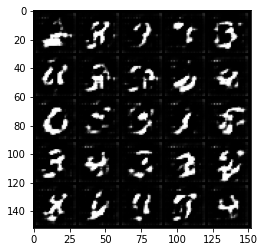

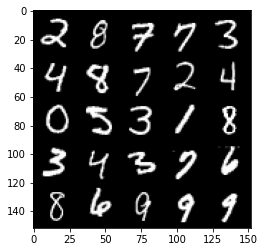

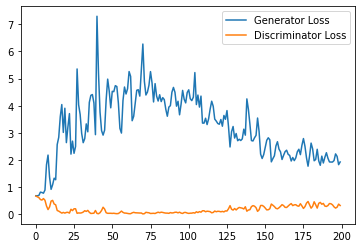

Step 4500: Generator loss: 2.026401310443878, discriminator loss: 0.3287470842897892


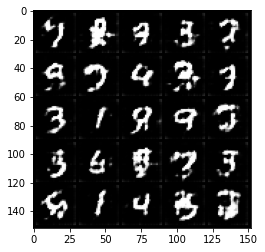

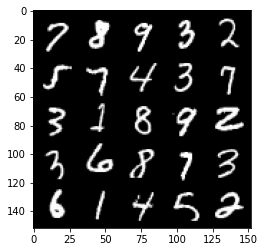

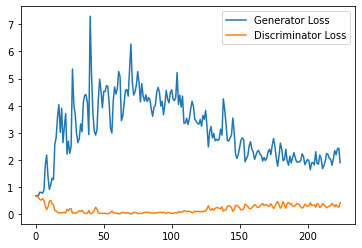

Step 5000: Generator loss: 2.0963721141815186, discriminator loss: 0.3340733720362186


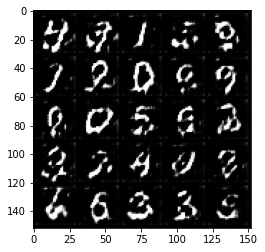

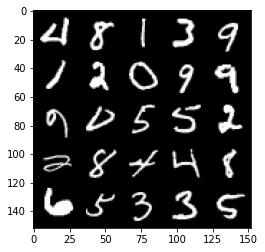

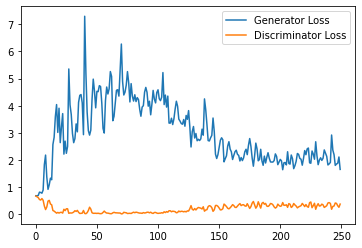

Step 5500: Generator loss: 1.7946627175807952, discriminator loss: 0.37626183742284774


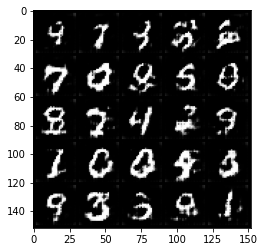

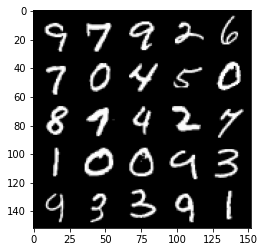

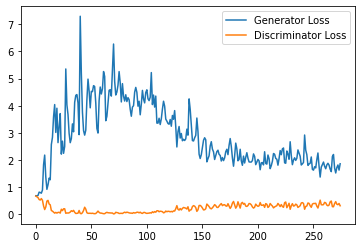

Step 6000: Generator loss: 1.7806904871463776, discriminator loss: 0.3709530564248562


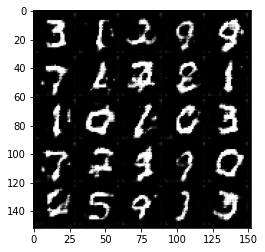

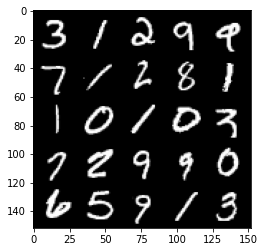

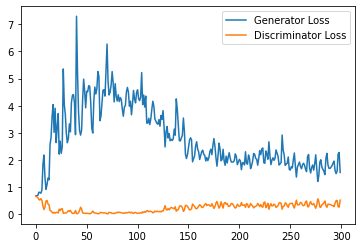

Step 6500: Generator loss: 1.6694333755970001, discriminator loss: 0.41559711799025534


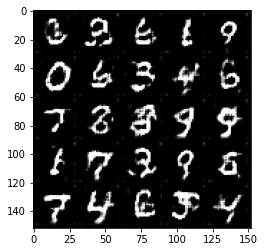

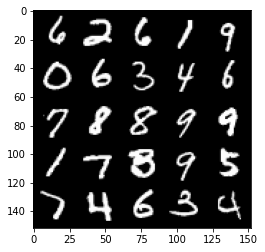

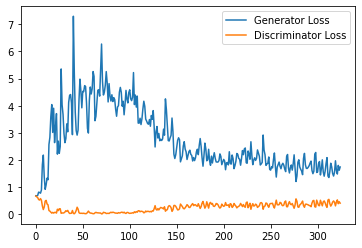

Step 7000: Generator loss: 1.6537179020643233, discriminator loss: 0.4458909482359886


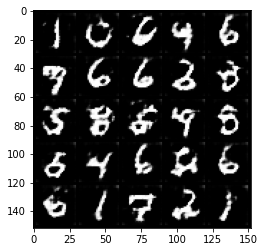

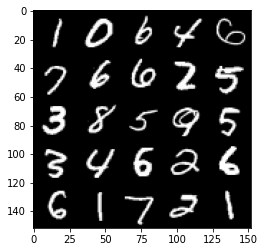

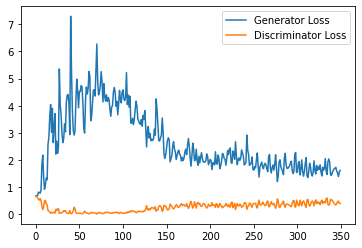

Step 7500: Generator loss: 1.4785217641592026, discriminator loss: 0.4610419062376022


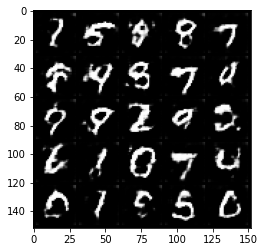

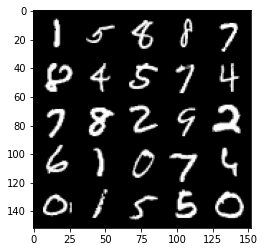

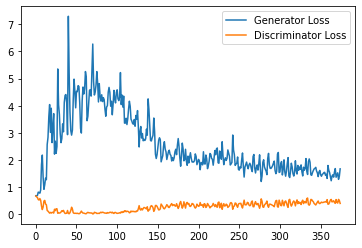

Step 8000: Generator loss: 1.4806043598651886, discriminator loss: 0.48930295938253404


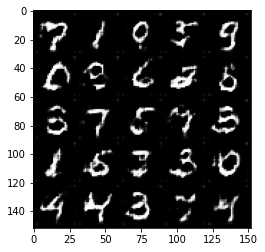

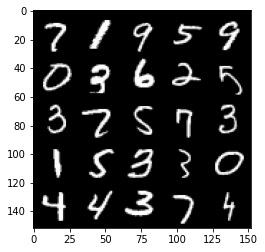

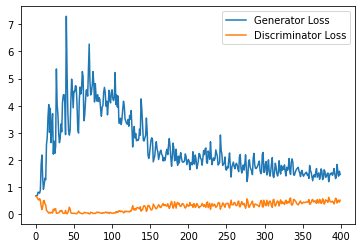

Step 8500: Generator loss: 1.4081392571926117, discriminator loss: 0.5154454824924469


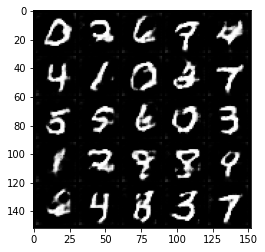

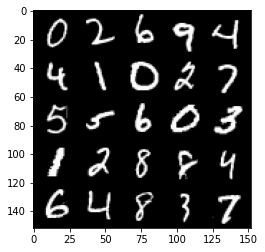

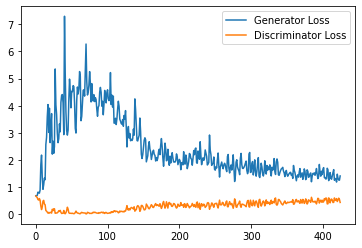

Step 9000: Generator loss: 1.299646264910698, discriminator loss: 0.5059067888855934


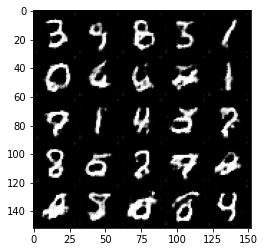

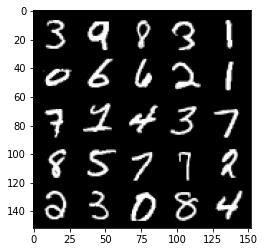

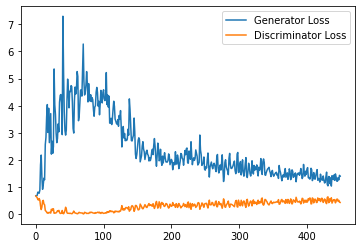

Step 9500: Generator loss: 1.3278305003643036, discriminator loss: 0.5350006195306778


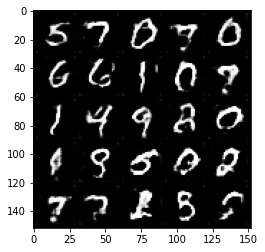

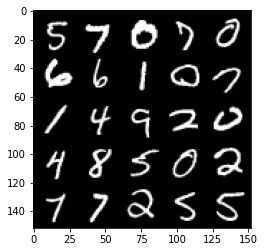

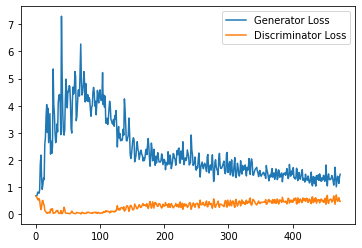

Step 10000: Generator loss: 1.1891461033821107, discriminator loss: 0.5399291597604752


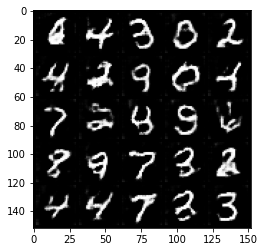

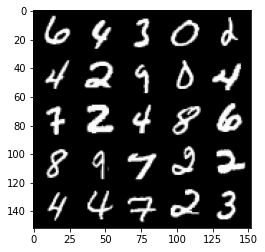

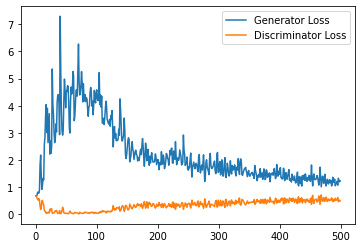

Step 10500: Generator loss: 1.2362906476259232, discriminator loss: 0.5364998685717582


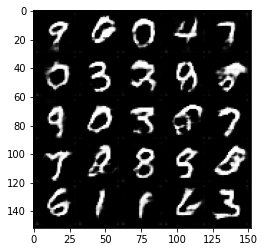

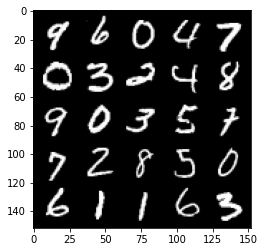

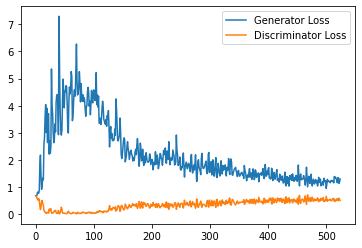

Step 11000: Generator loss: 1.2153286832571029, discriminator loss: 0.5371442778110505


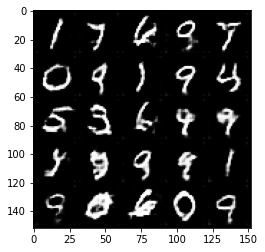

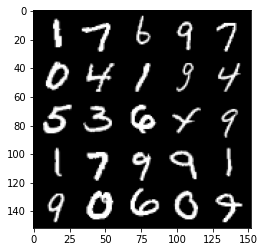

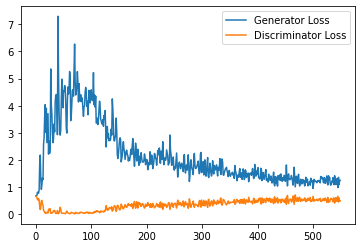

Step 11500: Generator loss: 1.1899112757444381, discriminator loss: 0.5548687049746513


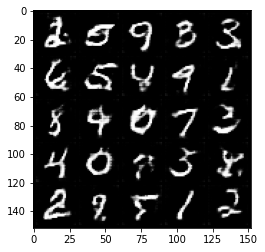

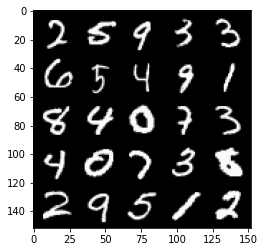

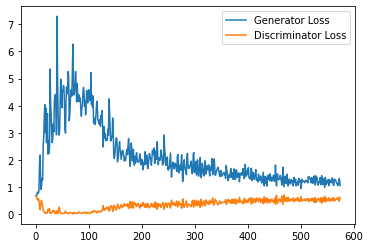

Step 12000: Generator loss: 1.1433063377141952, discriminator loss: 0.5471779437065124


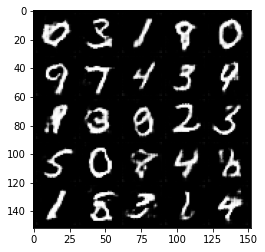

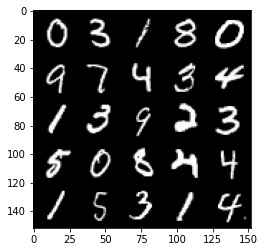

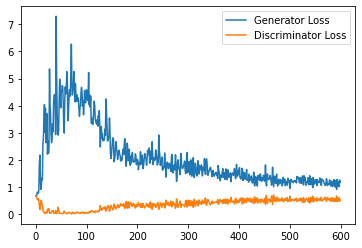

Step 12500: Generator loss: 1.208157184958458, discriminator loss: 0.5683636759519577


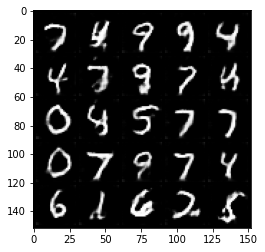

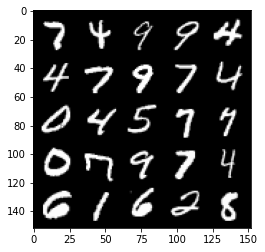

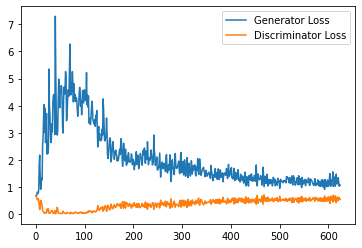

Step 13000: Generator loss: 1.1188781150579452, discriminator loss: 0.5596553922295571


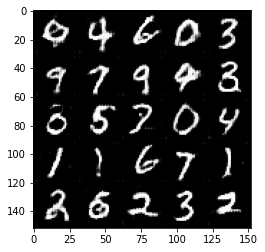

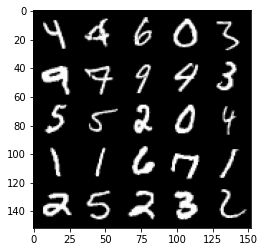

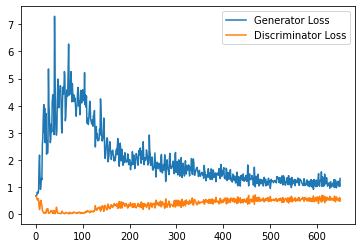

Step 13500: Generator loss: 1.1387274090051651, discriminator loss: 0.5540897871255874


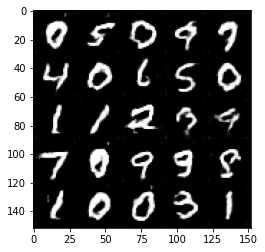

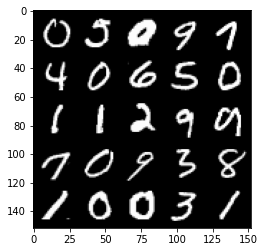

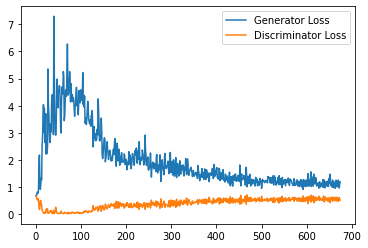

Step 14000: Generator loss: 1.1319995443820954, discriminator loss: 0.5540727022886276


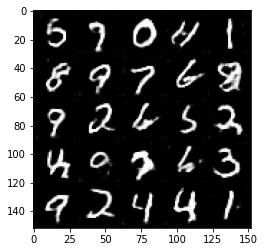

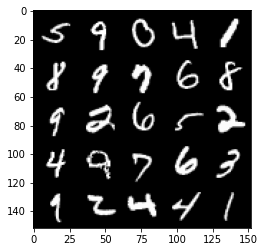

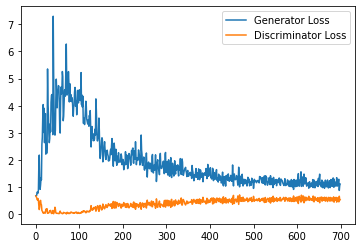

Step 14500: Generator loss: 1.1212682234048843, discriminator loss: 0.5599897297620773


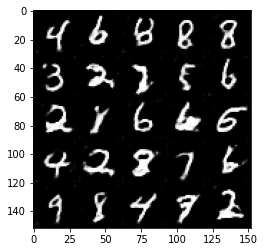

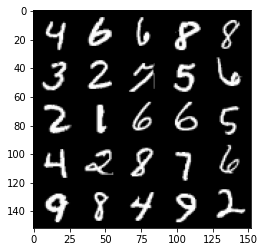

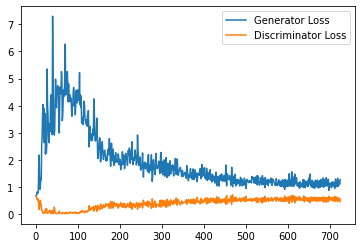

Step 15000: Generator loss: 1.0916393104791642, discriminator loss: 0.571581626534462


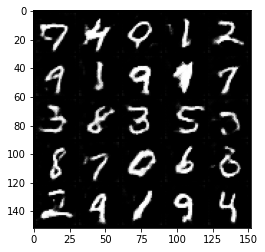

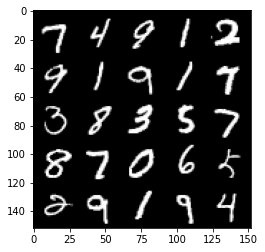

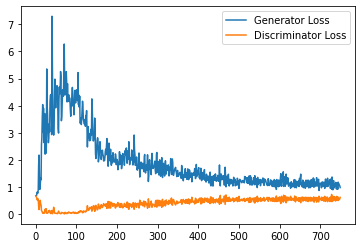

Step 15500: Generator loss: 1.1152871190309523, discriminator loss: 0.5639731392860413


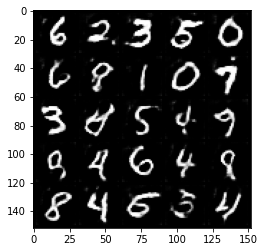

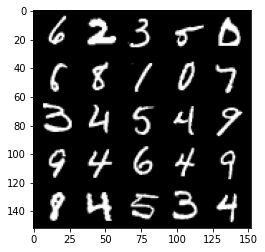

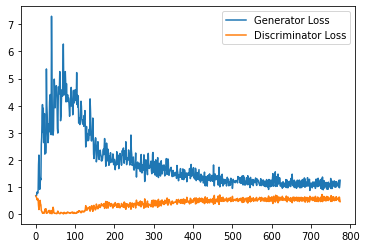

Step 16000: Generator loss: 1.0797172157764434, discriminator loss: 0.5675788247585296


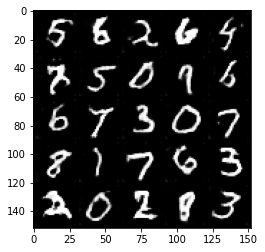

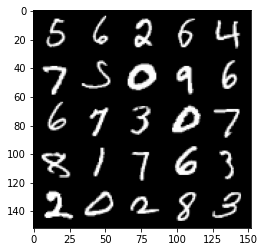

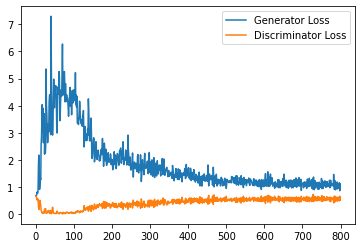

Step 16500: Generator loss: 1.0782107278108597, discriminator loss: 0.5697438259720802


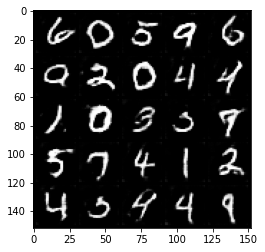

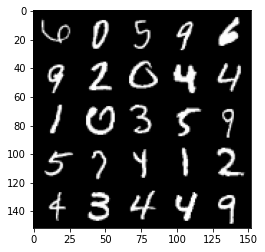

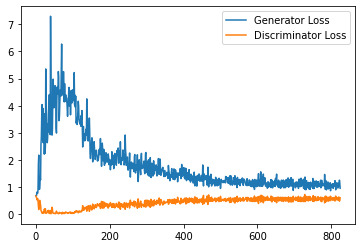

Step 17000: Generator loss: 1.0742311203479766, discriminator loss: 0.5652864282727241


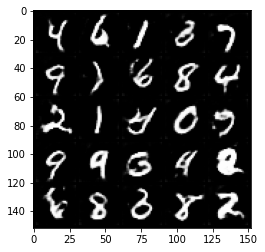

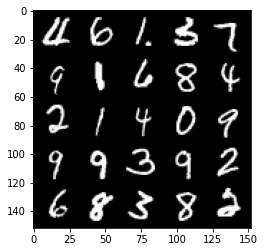

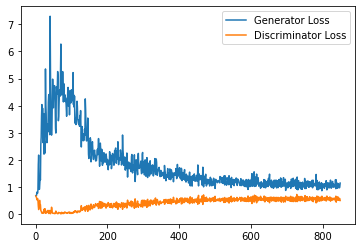

Step 17500: Generator loss: 1.0427106297016144, discriminator loss: 0.574196962416172


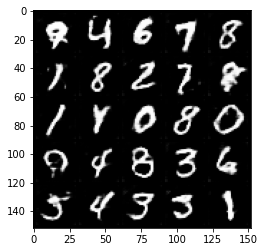

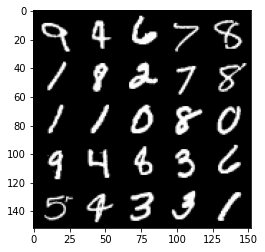

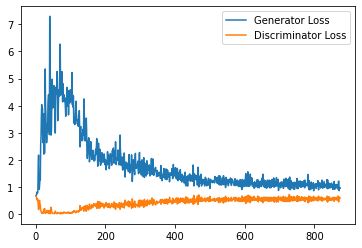

Step 18000: Generator loss: 1.0574688653945923, discriminator loss: 0.5713342584371567


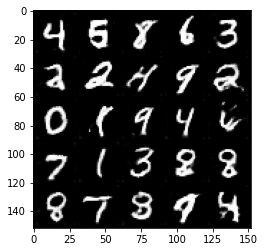

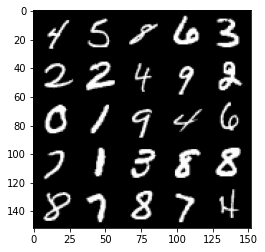

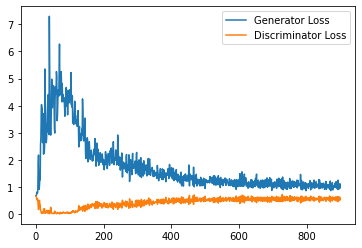

Step 18500: Generator loss: 1.0667846921682358, discriminator loss: 0.5807760504484176


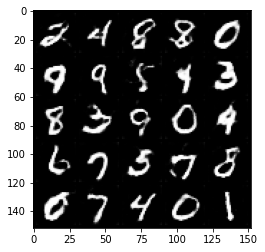

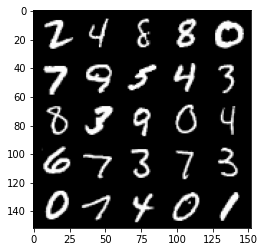

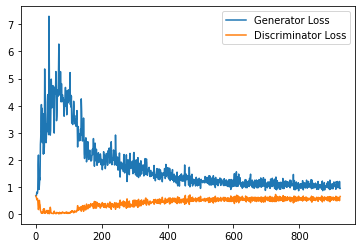

Step 19000: Generator loss: 1.0531463266611099, discriminator loss: 0.5797246969342231


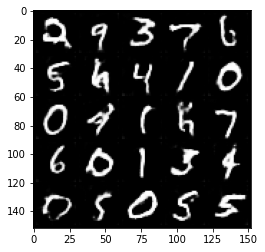

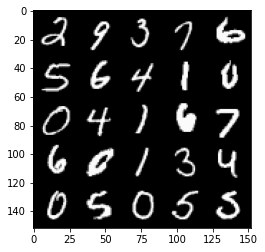

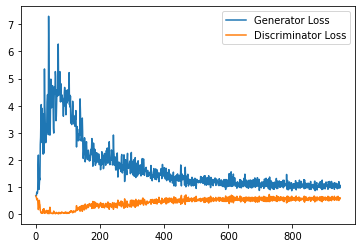

Step 19500: Generator loss: 1.0497779873609543, discriminator loss: 0.5791069138646125


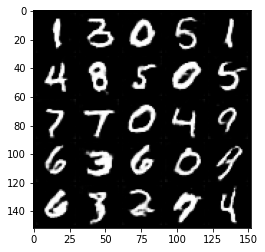

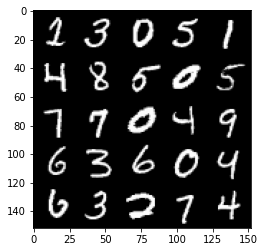

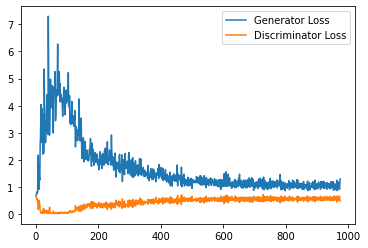

Step 20000: Generator loss: 1.052538157939911, discriminator loss: 0.5745296474695206


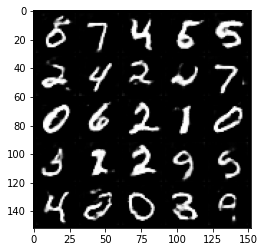

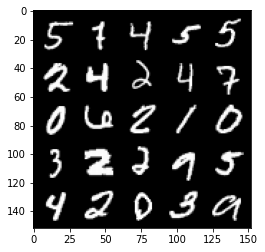

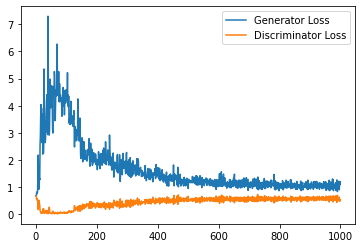

Step 20500: Generator loss: 1.0140052441358567, discriminator loss: 0.584512133717537


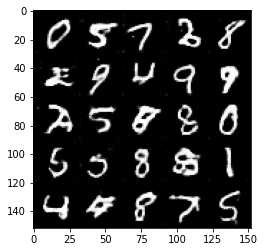

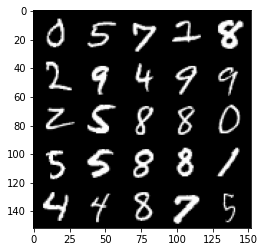

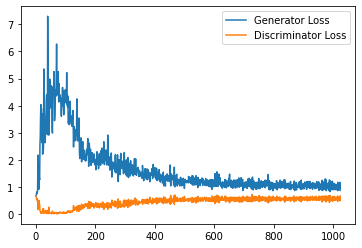

Step 21000: Generator loss: 1.0402325679063797, discriminator loss: 0.5755212751030921


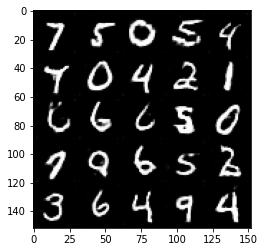

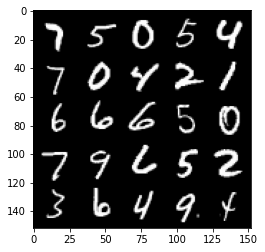

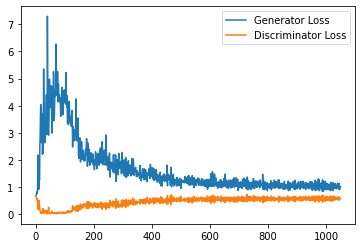

Step 21500: Generator loss: 1.0389565918445587, discriminator loss: 0.5797508841753006


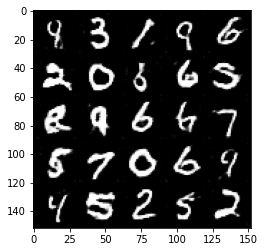

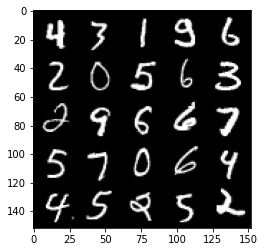

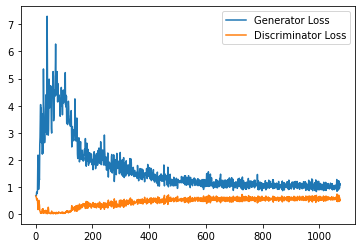

Step 22000: Generator loss: 1.0150990114212035, discriminator loss: 0.5894404151439667


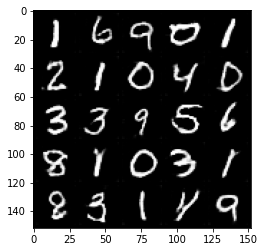

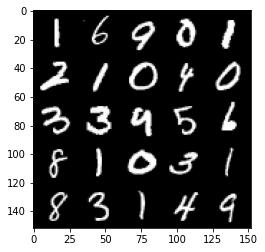

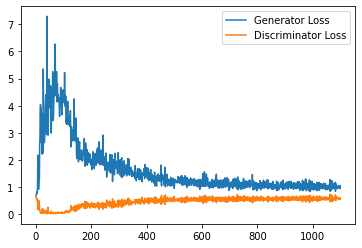

Step 22500: Generator loss: 1.0346824712753295, discriminator loss: 0.582029231607914


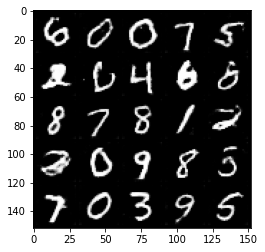

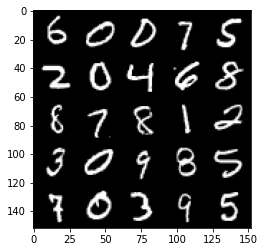

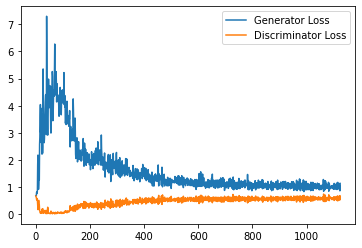

Step 23000: Generator loss: 1.0281503562927246, discriminator loss: 0.5814604010581971


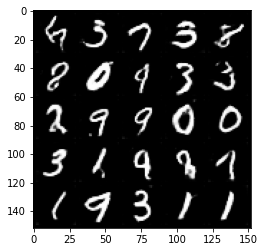

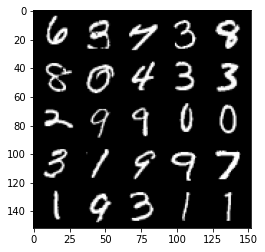

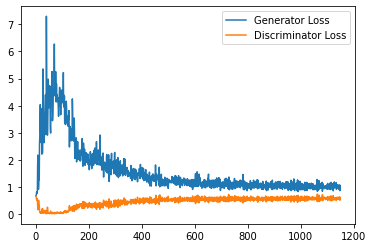

Step 23500: Generator loss: 0.9935786286592484, discriminator loss: 0.5857021163702011


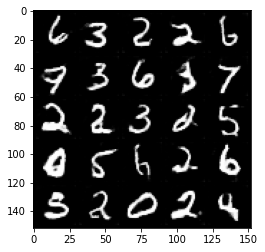

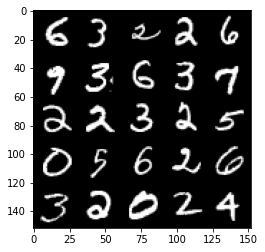

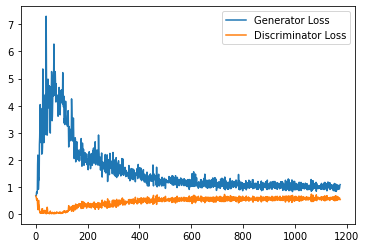

Step 24000: Generator loss: 1.00198632979393, discriminator loss: 0.5926699832677841


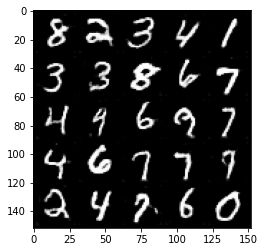

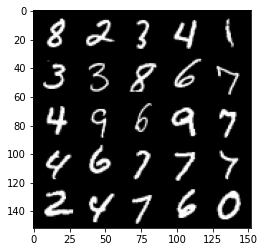

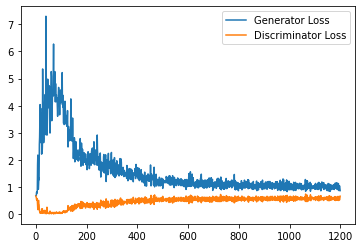

Step 24500: Generator loss: 1.0237241086959838, discriminator loss: 0.592429181933403


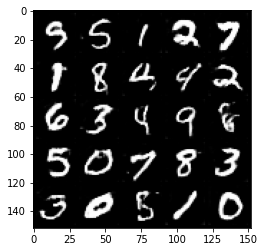

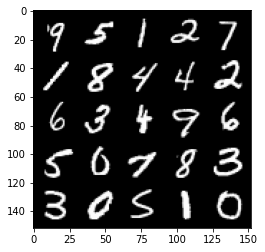

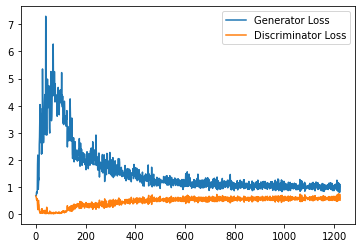

Step 25000: Generator loss: 0.9710364739894867, discriminator loss: 0.5924389569759368


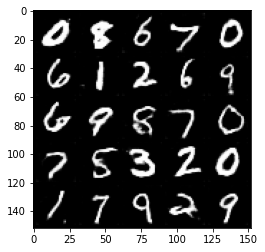

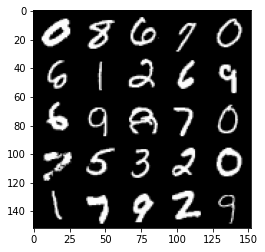

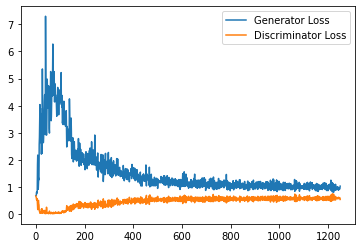

Step 25500: Generator loss: 1.0052909398078917, discriminator loss: 0.5998974636793136


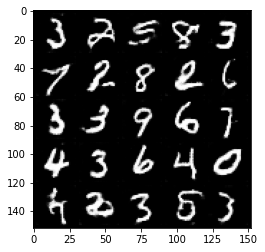

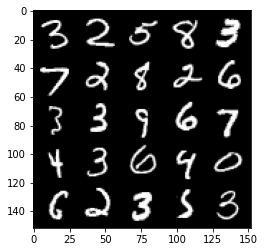

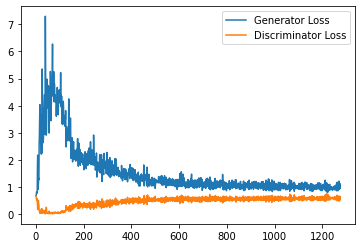

Step 26000: Generator loss: 0.995246682882309, discriminator loss: 0.6015952618718148


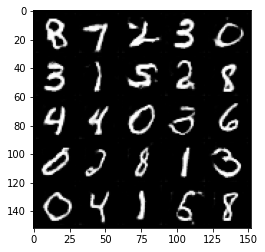

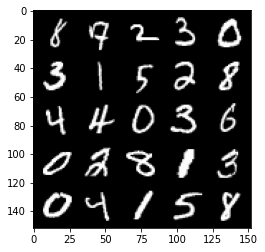

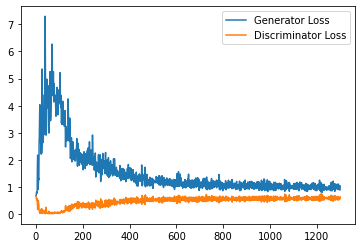

Step 26500: Generator loss: 0.9844286545515061, discriminator loss: 0.6081471802592278


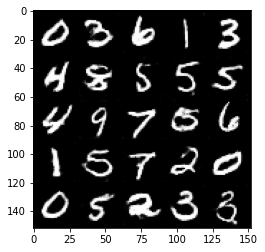

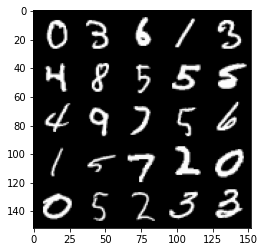

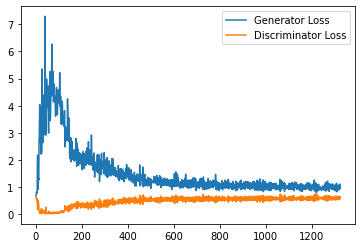

Step 27000: Generator loss: 0.9664169994592666, discriminator loss: 0.6016976632475853


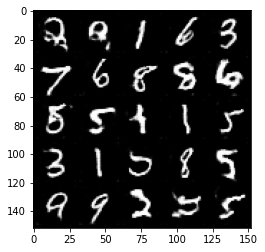

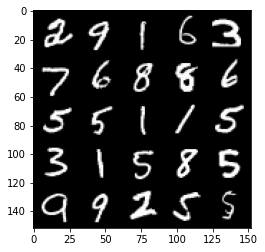

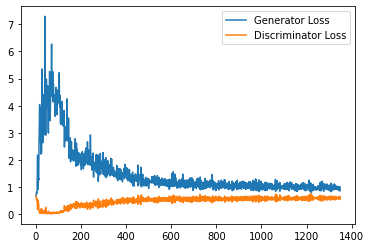

Step 27500: Generator loss: 0.9840707416534424, discriminator loss: 0.6051087893843651


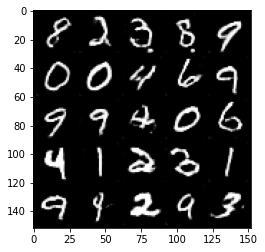

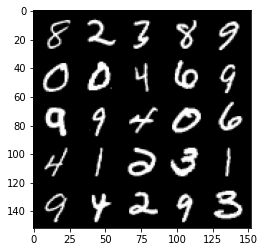

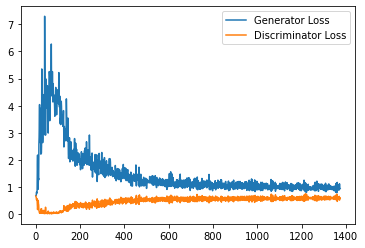

Step 28000: Generator loss: 0.959142446398735, discriminator loss: 0.6077634741663933


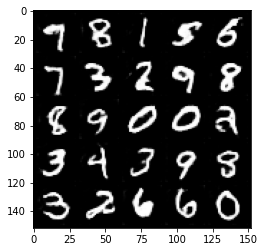

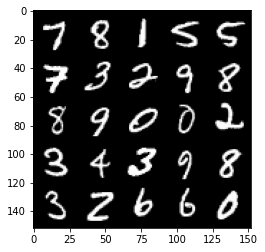

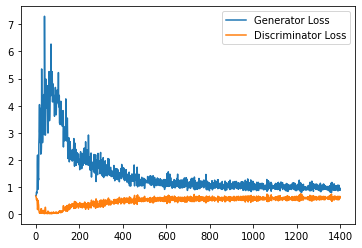

Step 28500: Generator loss: 0.9505456187725068, discriminator loss: 0.6071357057690621


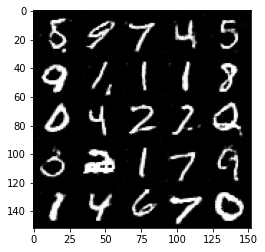

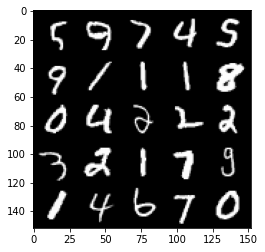

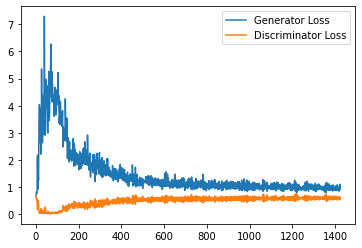

Step 29000: Generator loss: 0.9742707415819168, discriminator loss: 0.6077132172584534


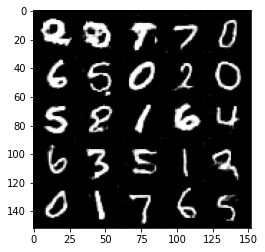

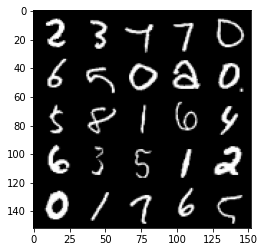

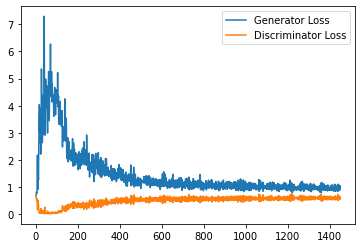

Step 29500: Generator loss: 0.9806175073385238, discriminator loss: 0.609650472342968


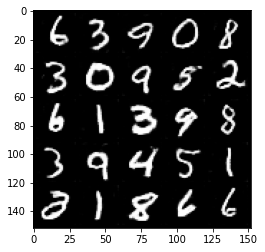

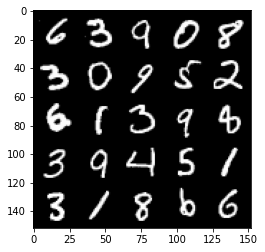

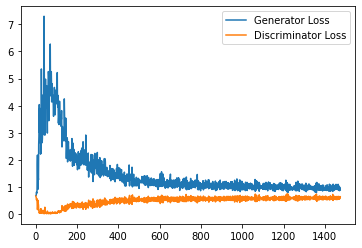

Step 30000: Generator loss: 0.9543904700279235, discriminator loss: 0.6051238892674446


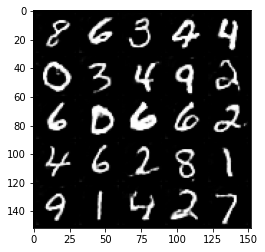

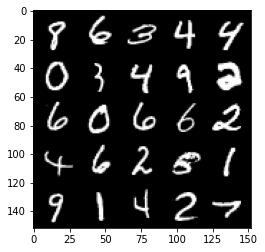

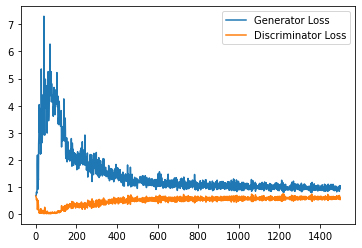

Step 30500: Generator loss: 0.9460612092018127, discriminator loss: 0.6088259252905845


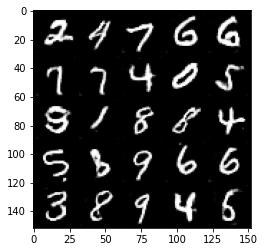

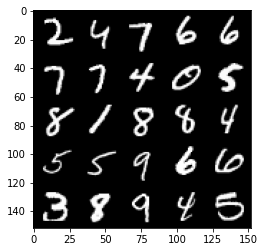

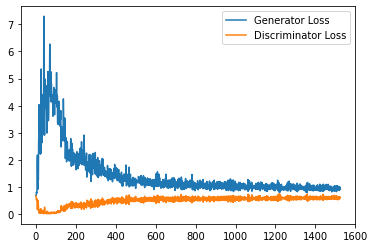

Step 31000: Generator loss: 0.9364601989984512, discriminator loss: 0.609534391283989


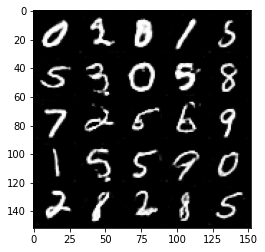

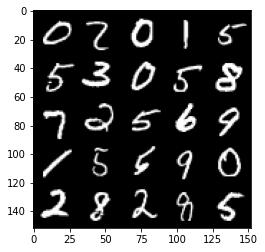

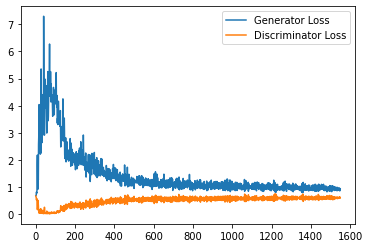

Step 31500: Generator loss: 0.9484055252075195, discriminator loss: 0.6135086267590523


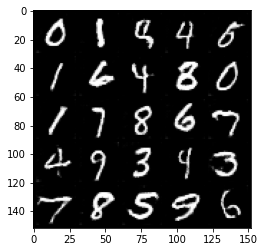

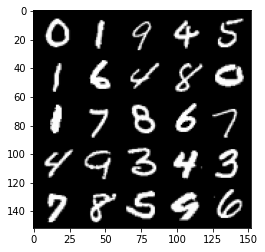

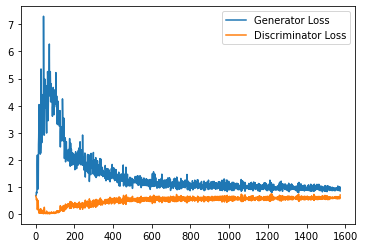

Step 32000: Generator loss: 0.9845776529312134, discriminator loss: 0.6066929604411125


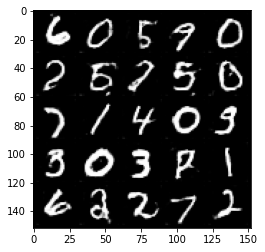

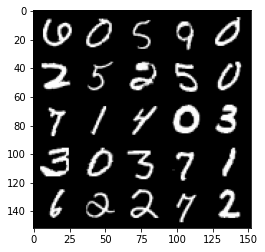

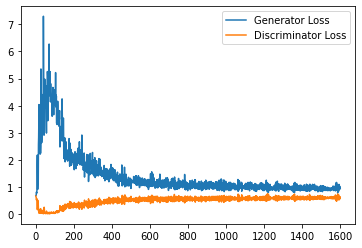

Step 32500: Generator loss: 0.9592263079881668, discriminator loss: 0.6107910288572311


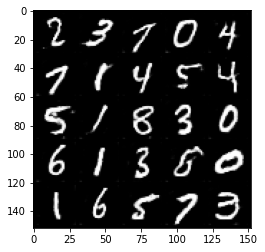

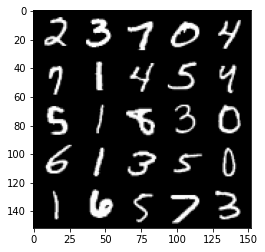

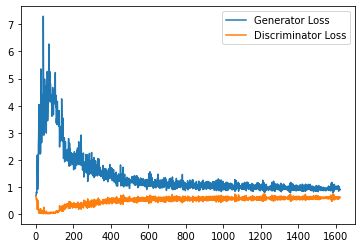

Step 33000: Generator loss: 0.9823166873455048, discriminator loss: 0.6062970539927482


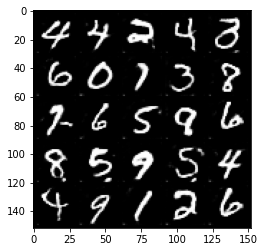

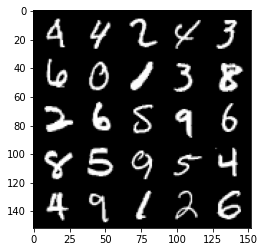

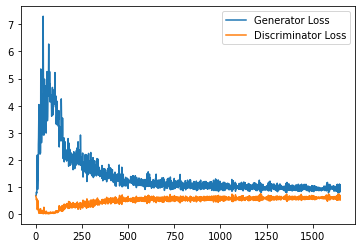

Step 33500: Generator loss: 0.968656520485878, discriminator loss: 0.6118493089675904


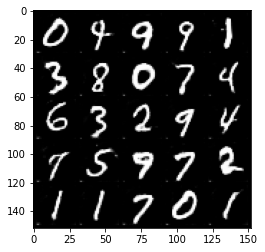

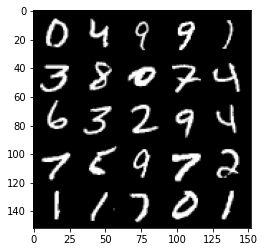

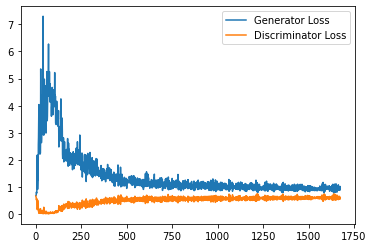

Step 34000: Generator loss: 0.9602602632045746, discriminator loss: 0.611644446015358


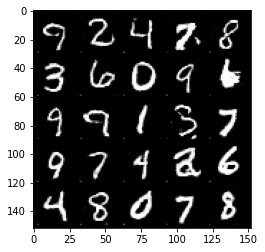

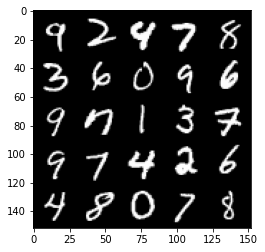

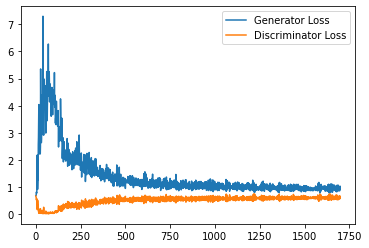

Step 34500: Generator loss: 0.9590478081703186, discriminator loss: 0.6122051005959511


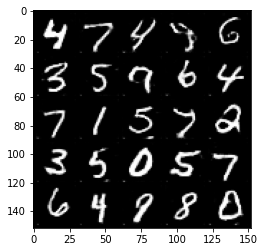

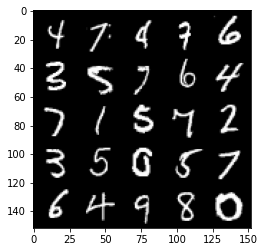

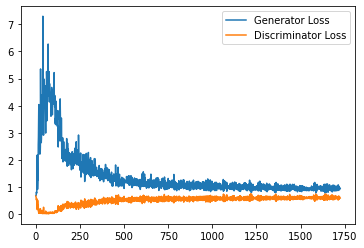

Step 35000: Generator loss: 0.9377860414981842, discriminator loss: 0.6102197034955025


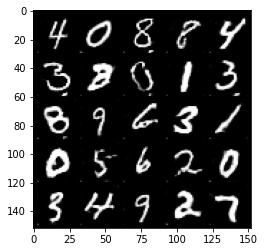

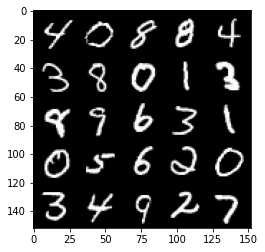

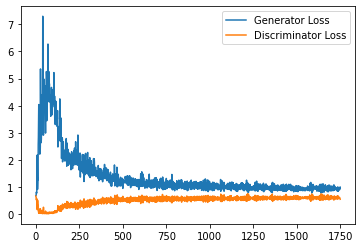

Step 35500: Generator loss: 0.9694868042469025, discriminator loss: 0.6165875489711762


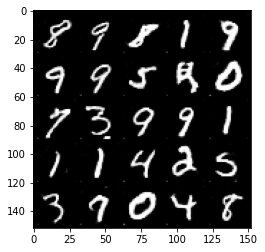

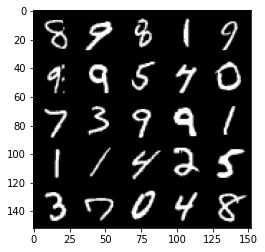

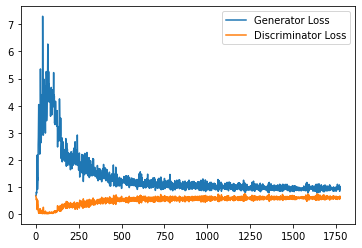

Step 36000: Generator loss: 0.9612217032909394, discriminator loss: 0.6117697541713715


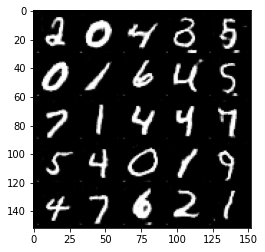

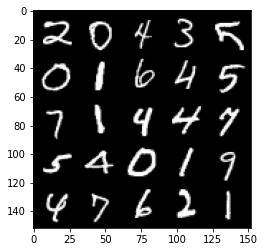

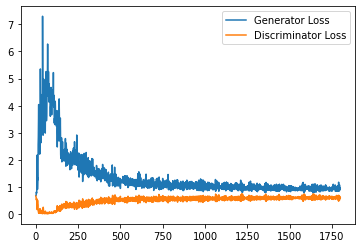

Step 36500: Generator loss: 0.9534470460414887, discriminator loss: 0.6123987951874733


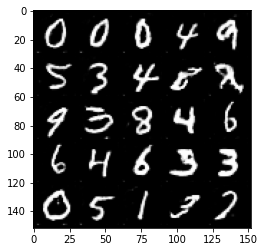

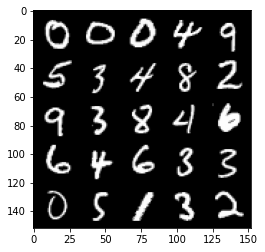

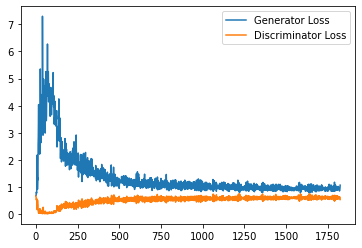

Step 37000: Generator loss: 0.9319408558607102, discriminator loss: 0.6160466836690903


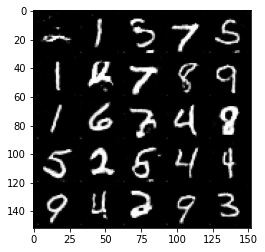

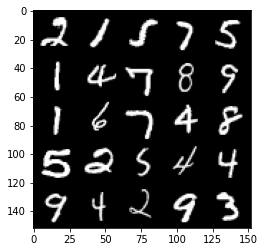

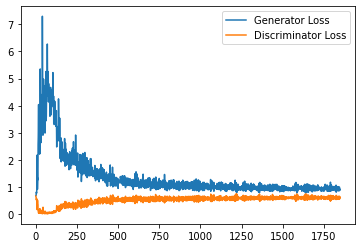

Step 37500: Generator loss: 0.9523739285469055, discriminator loss: 0.6139331479668617


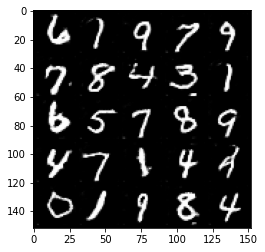

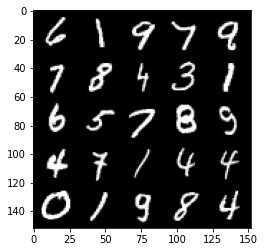

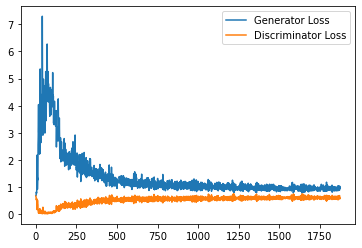

Step 38000: Generator loss: 0.9551330066919327, discriminator loss: 0.6197685772180557


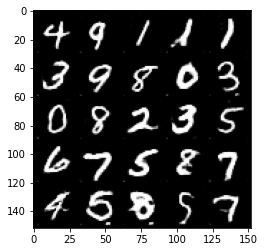

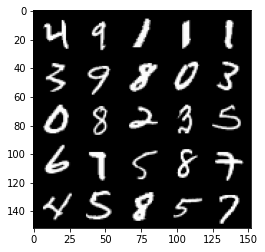

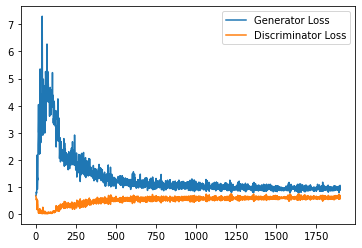

Step 38500: Generator loss: 0.9415363091230392, discriminator loss: 0.6166922791004181


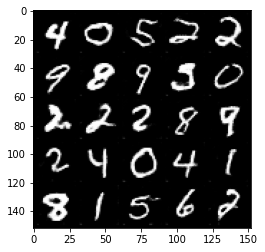

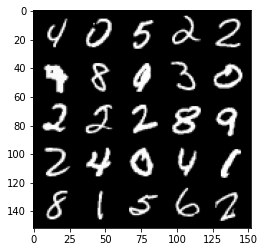

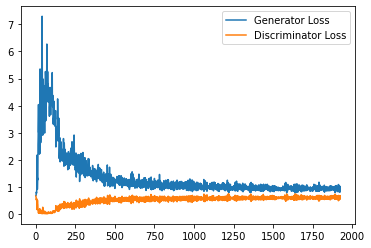

Step 39000: Generator loss: 0.9531208627223968, discriminator loss: 0.6091895627379418


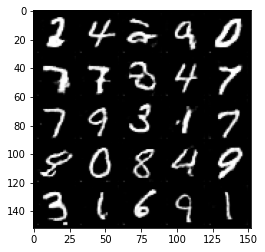

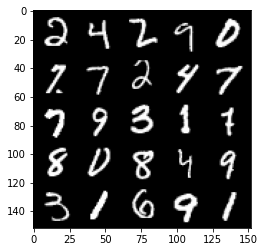

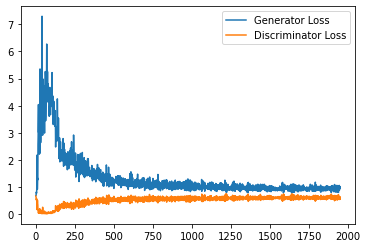

Step 39500: Generator loss: 0.9507875006198883, discriminator loss: 0.6176876156926155


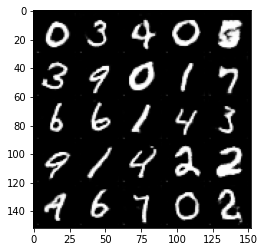

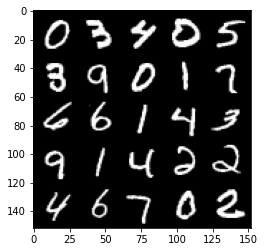

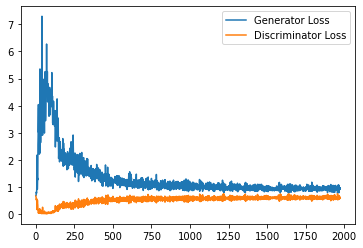

Step 40000: Generator loss: 0.9262468358278274, discriminator loss: 0.6136520530581474


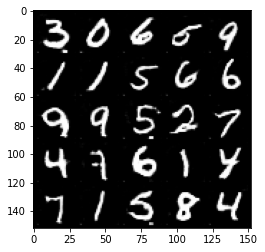

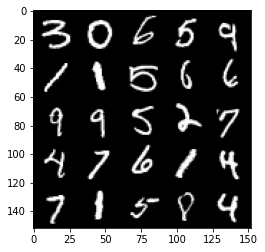

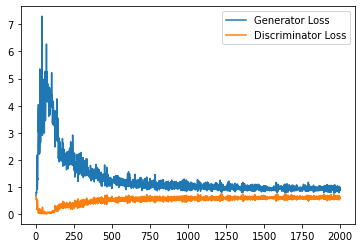

Step 40500: Generator loss: 0.9511002277135849, discriminator loss: 0.6107020825743675


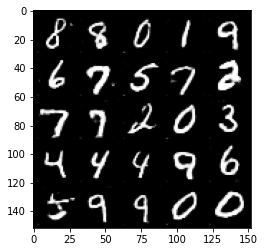

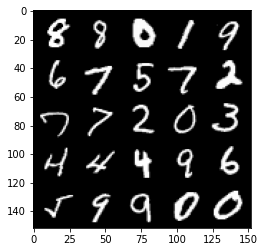

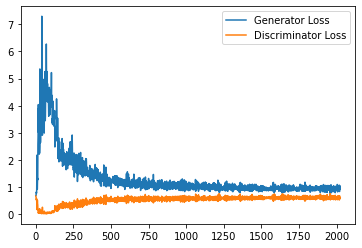

Step 41000: Generator loss: 0.964737135887146, discriminator loss: 0.6098394693732262


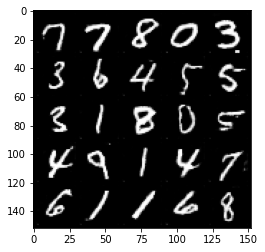

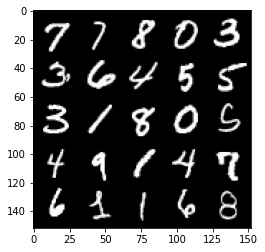

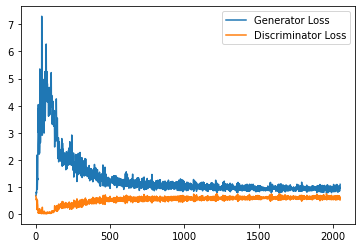

Step 41500: Generator loss: 0.9502014343738556, discriminator loss: 0.6125352522730827


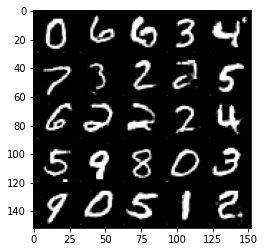

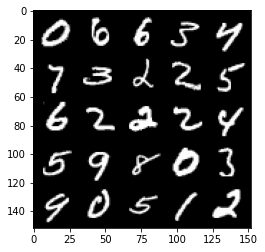

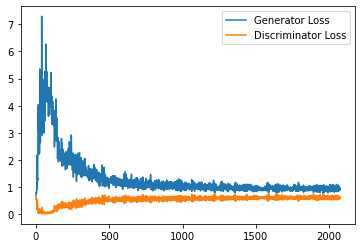

Step 42000: Generator loss: 0.9665736840963364, discriminator loss: 0.6127775058746338


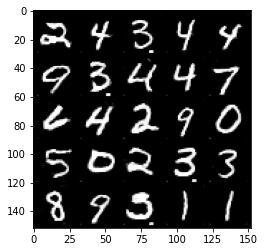

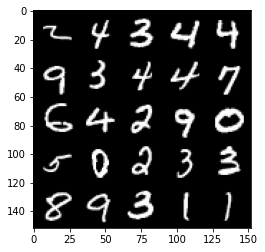

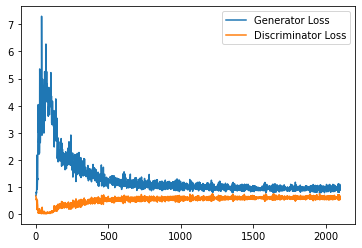

Step 42500: Generator loss: 0.9516527880430221, discriminator loss: 0.6124004759788513


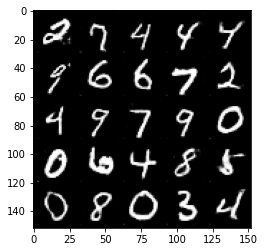

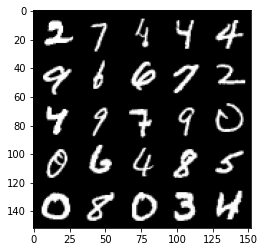

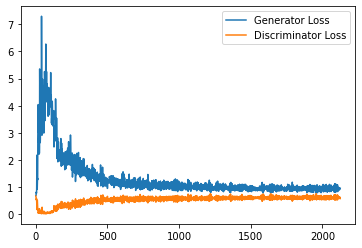

Step 43000: Generator loss: 0.9335121179819107, discriminator loss: 0.6138318281173706


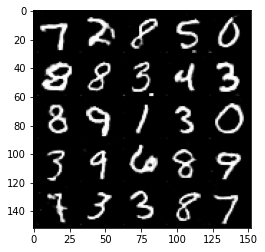

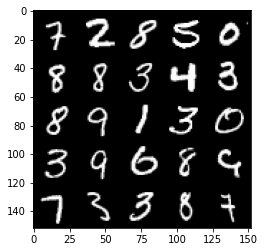

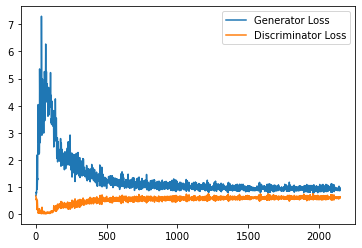

Step 43500: Generator loss: 0.9410877760648727, discriminator loss: 0.6163494488596917


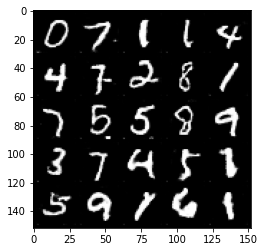

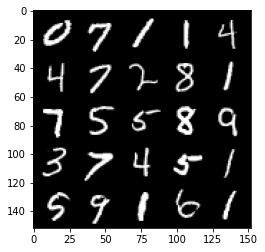

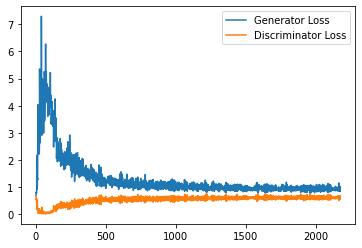

Step 44000: Generator loss: 0.9515053884983062, discriminator loss: 0.6099351758360863


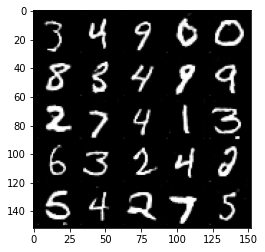

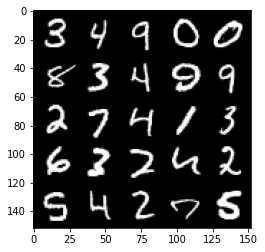

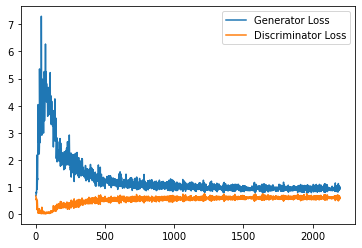

Step 44500: Generator loss: 0.9493590667247772, discriminator loss: 0.6140410633087158


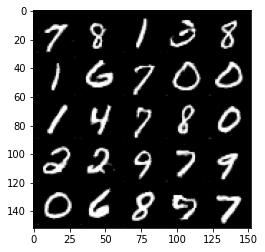

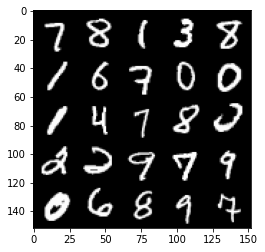

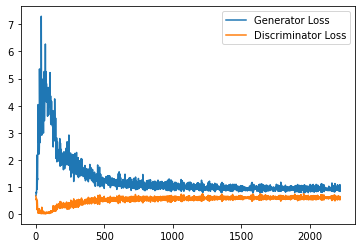

Step 45000: Generator loss: 0.9391971642971039, discriminator loss: 0.6157570085525512


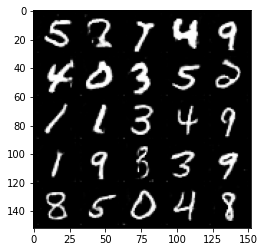

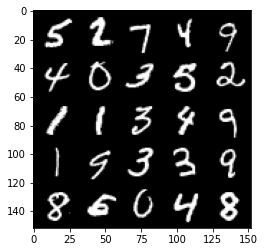

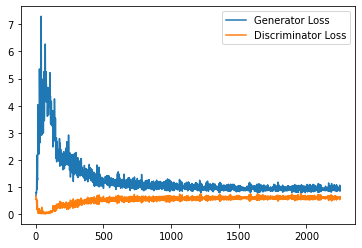

Step 45500: Generator loss: 0.9428139363527298, discriminator loss: 0.6145274948477745


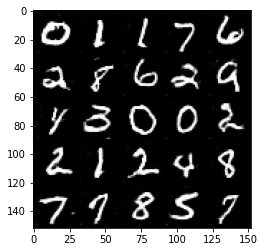

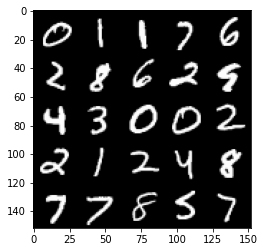

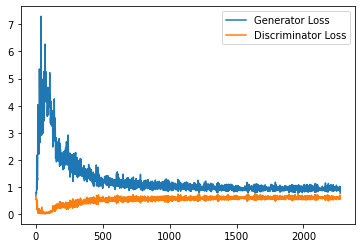

Step 46000: Generator loss: 0.9599258879423141, discriminator loss: 0.6074503324627877


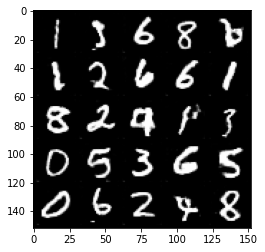

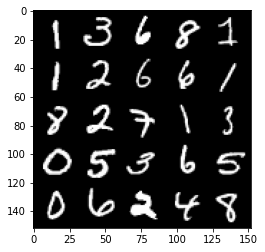

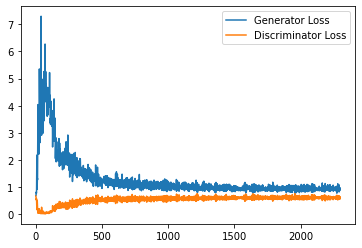

Step 46500: Generator loss: 0.9450056822299957, discriminator loss: 0.6143387625813485


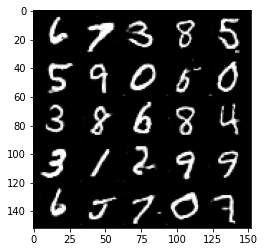

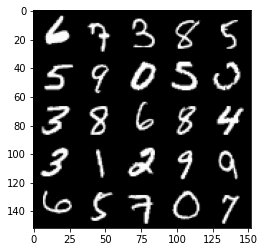

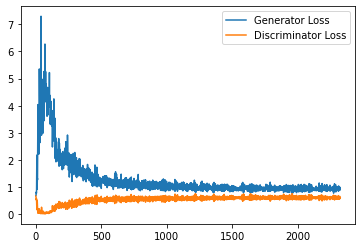

Step 47000: Generator loss: 0.958642671585083, discriminator loss: 0.6112415395379066


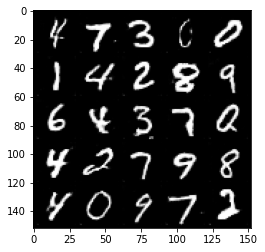

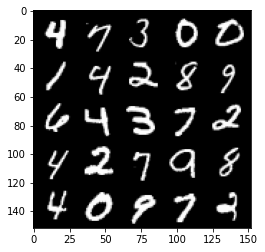

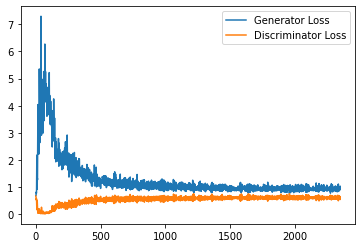

Step 47500: Generator loss: 0.936881855726242, discriminator loss: 0.616880404829979


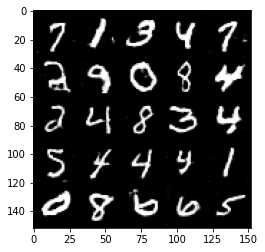

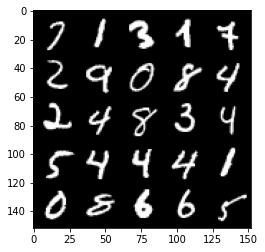

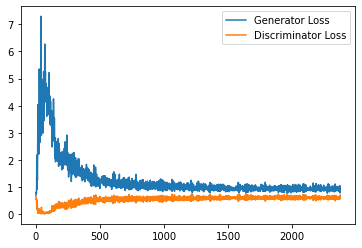

Step 48000: Generator loss: 0.9304239724874497, discriminator loss: 0.6142731133699417


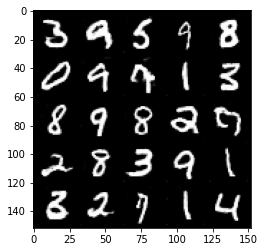

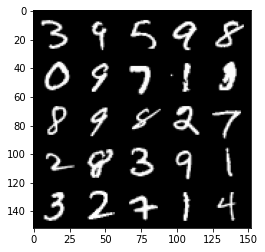

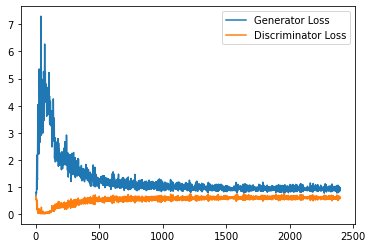

Step 48500: Generator loss: 0.9348141437768936, discriminator loss: 0.6165307742357254


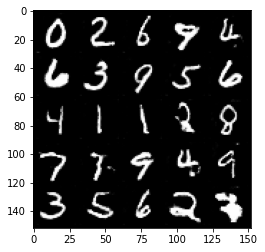

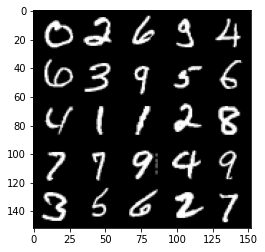

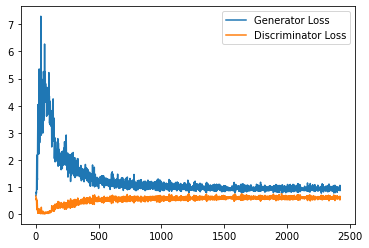

Step 49000: Generator loss: 0.957818110704422, discriminator loss: 0.6132428176403045


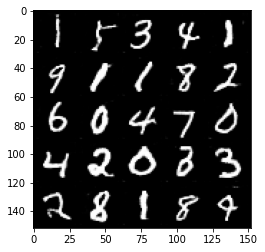

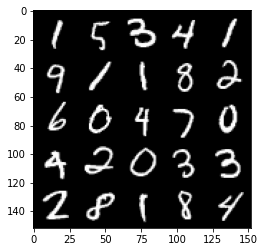

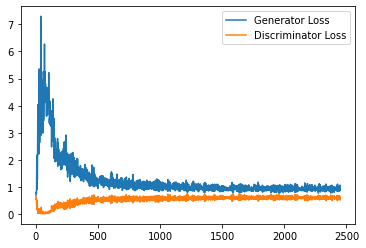

Step 49500: Generator loss: 0.941803429365158, discriminator loss: 0.6174292296171189


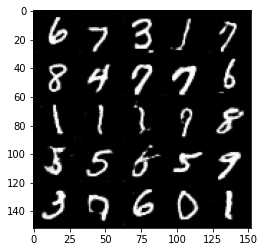

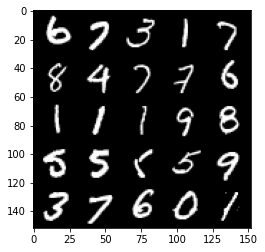

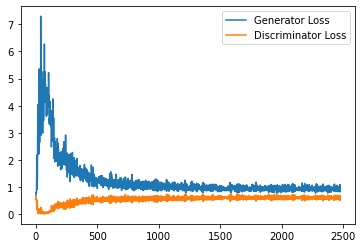

Step 50000: Generator loss: 0.9393651608228684, discriminator loss: 0.616222283065319


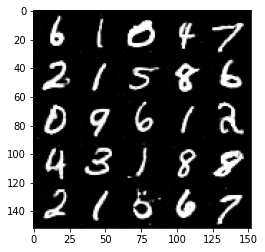

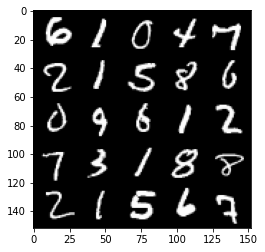

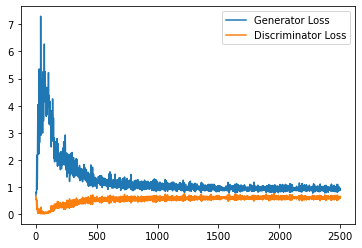

Step 50500: Generator loss: 0.9324102240800858, discriminator loss: 0.6162148205637932


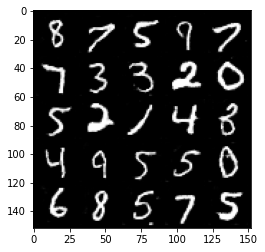

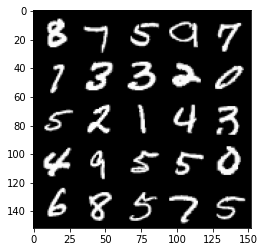

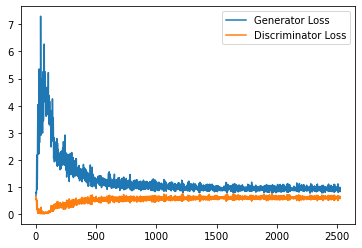

Step 51000: Generator loss: 0.9421513168811798, discriminator loss: 0.617461842417717


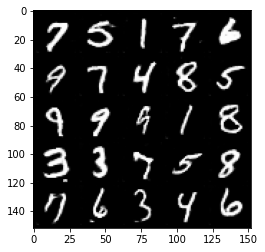

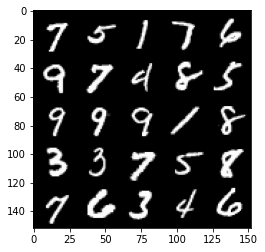

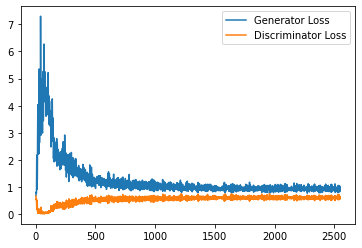

Step 51500: Generator loss: 0.9374178830385208, discriminator loss: 0.6163667517900467


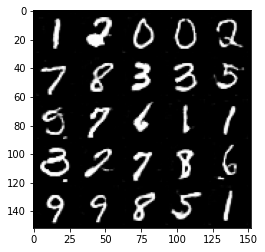

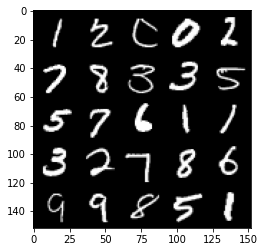

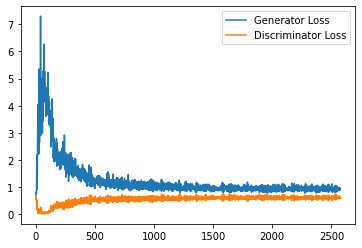

Step 52000: Generator loss: 0.9502993685007095, discriminator loss: 0.6158790333867074


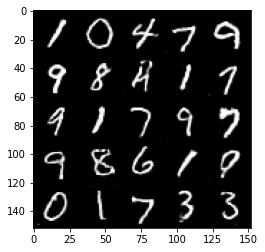

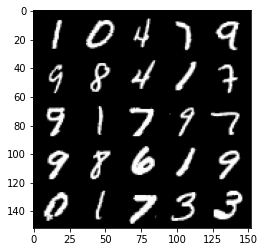

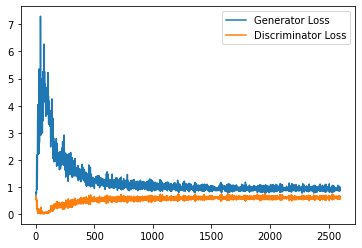

Step 52500: Generator loss: 0.9372006222009659, discriminator loss: 0.6185218672752381


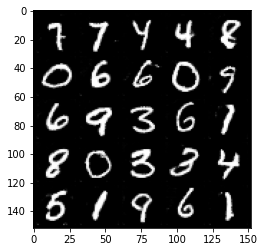

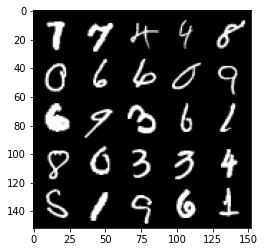

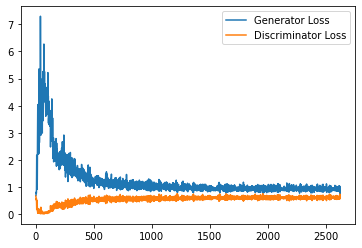

Step 53000: Generator loss: 0.9463457344770432, discriminator loss: 0.6156038206815719


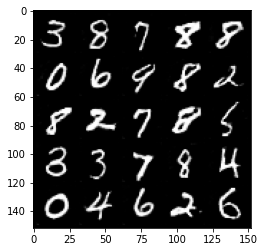

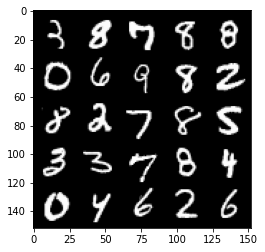

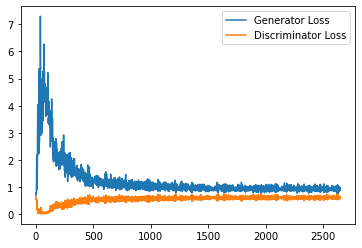

Step 53500: Generator loss: 0.9201175801753998, discriminator loss: 0.6204319740533829


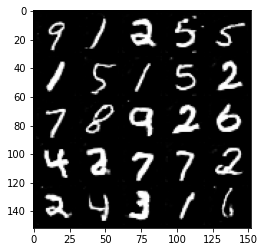

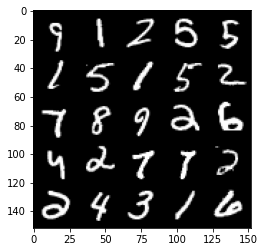

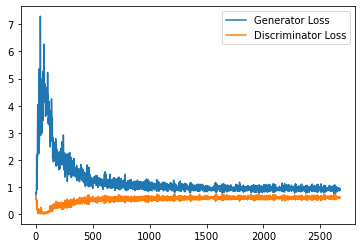

Step 54000: Generator loss: 0.9374257317781448, discriminator loss: 0.6200316650867462


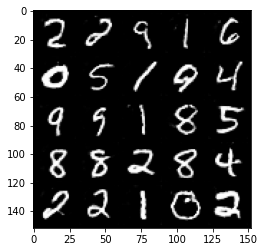

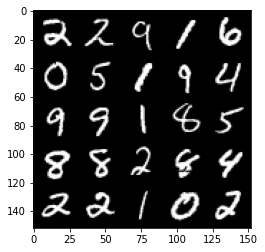

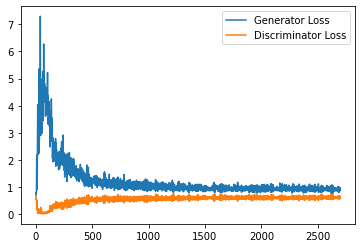

Step 54500: Generator loss: 0.9451851239204406, discriminator loss: 0.6168235191702842


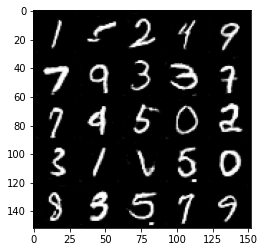

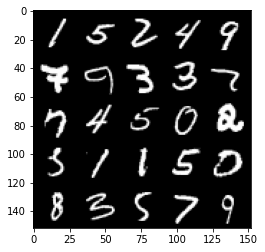

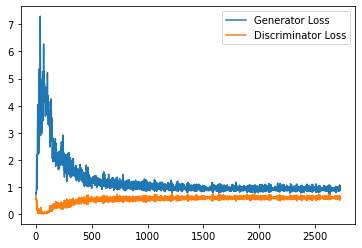

Step 55000: Generator loss: 0.9294390923976898, discriminator loss: 0.6184650932550431


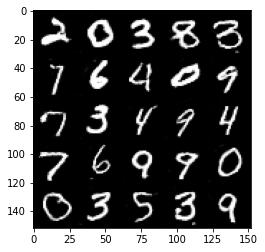

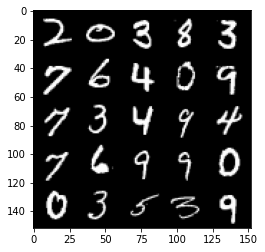

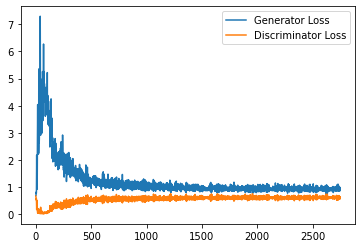

Step 55500: Generator loss: 0.9191733665466308, discriminator loss: 0.6178933211565018


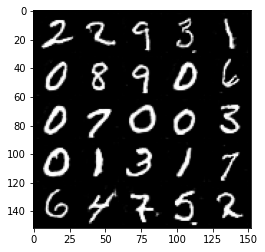

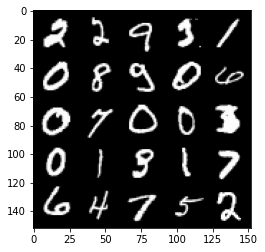

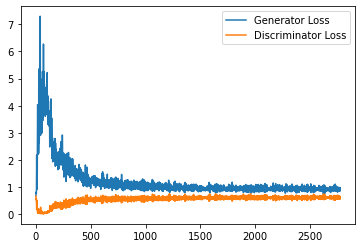

Step 56000: Generator loss: 0.9238683835268021, discriminator loss: 0.6204472208023071


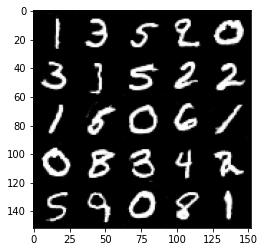

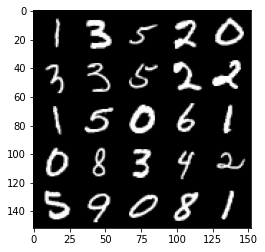

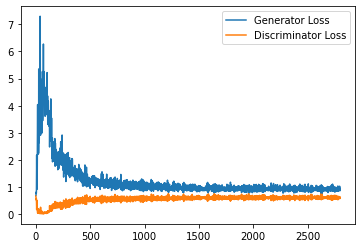

Step 56500: Generator loss: 0.9352353984117507, discriminator loss: 0.6223019104599953


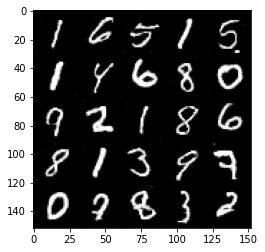

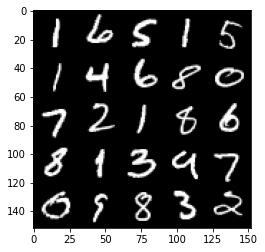

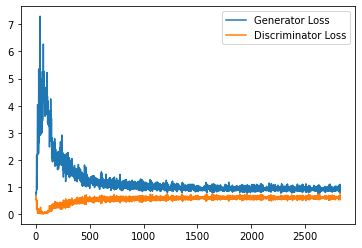

Step 57000: Generator loss: 0.9425407935380936, discriminator loss: 0.6163493555188179


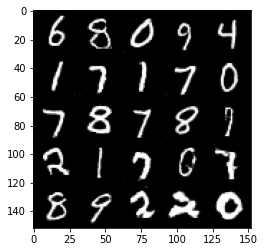

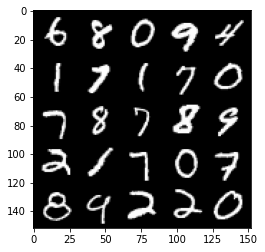

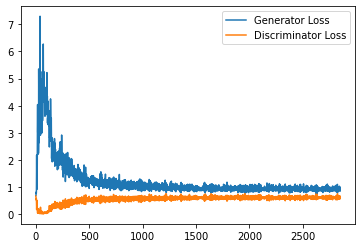

Step 57500: Generator loss: 0.9238414721488952, discriminator loss: 0.619830109834671


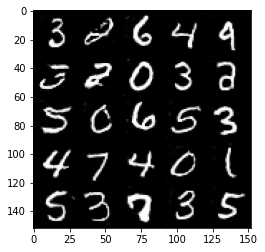

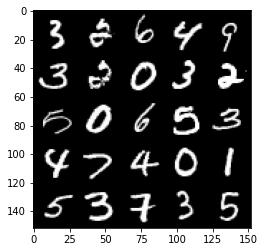

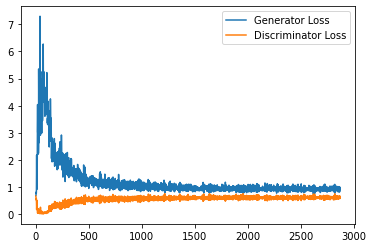

Step 58000: Generator loss: 0.9302456214427948, discriminator loss: 0.624161654651165


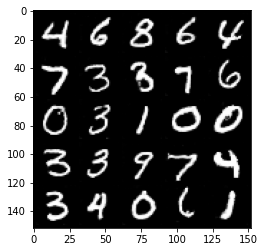

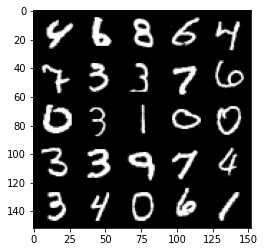

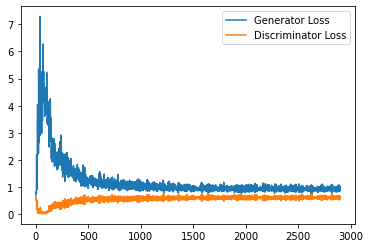

Step 58500: Generator loss: 0.9223228291273117, discriminator loss: 0.6206693338155747


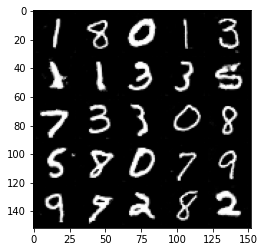

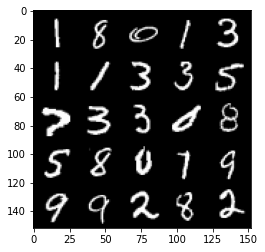

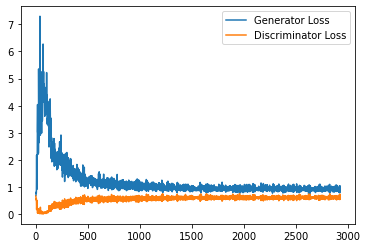

Step 59000: Generator loss: 0.9255127922296524, discriminator loss: 0.6240136469602585


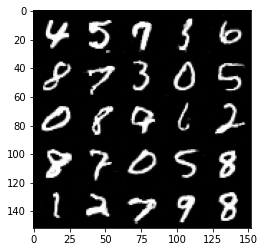

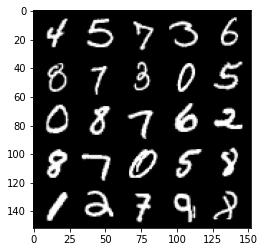

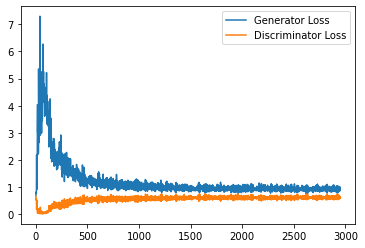

Step 59500: Generator loss: 0.9179627941846847, discriminator loss: 0.6190323421359062


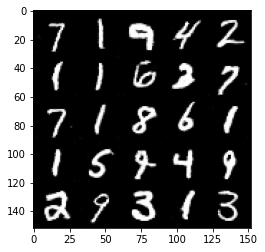

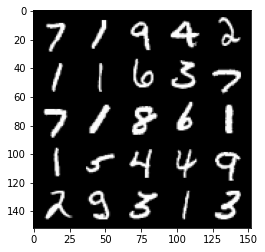

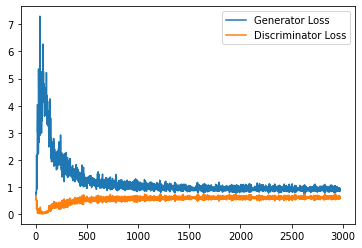

Step 60000: Generator loss: 0.932561385512352, discriminator loss: 0.6213523291349411


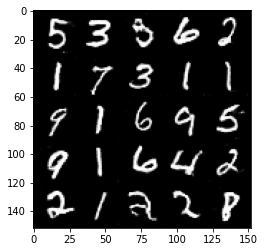

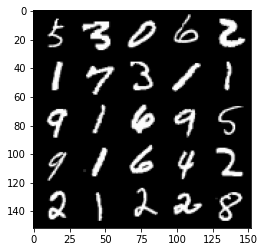

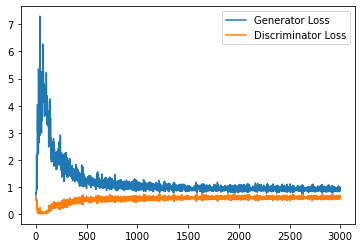

Step 60500: Generator loss: 0.9229513894319534, discriminator loss: 0.6228926433324814


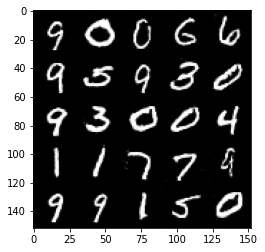

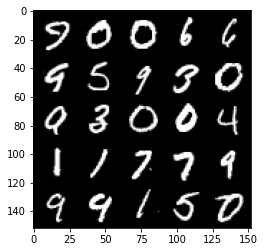

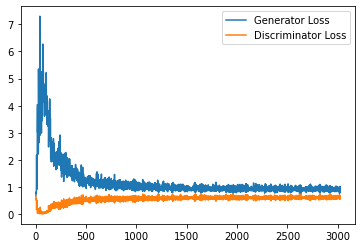

Step 61000: Generator loss: 0.9251914572715759, discriminator loss: 0.621595811843872


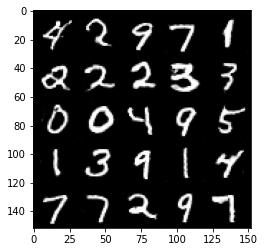

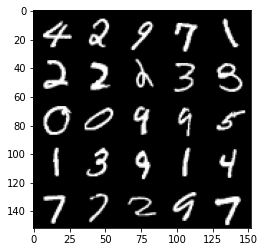

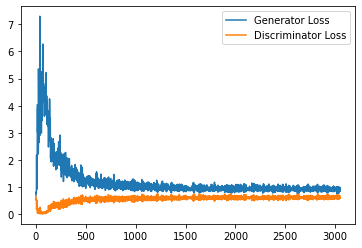

Step 61500: Generator loss: 0.9202962226867676, discriminator loss: 0.6190674716830253


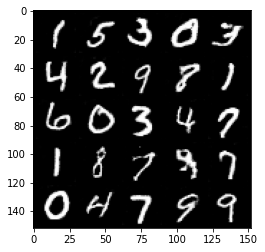

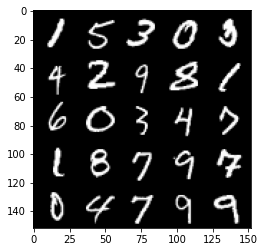

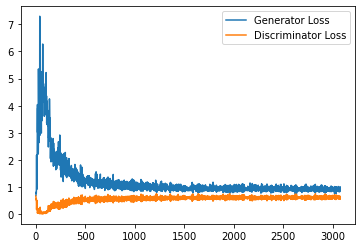

Step 62000: Generator loss: 0.9358325988054276, discriminator loss: 0.6260050025582313


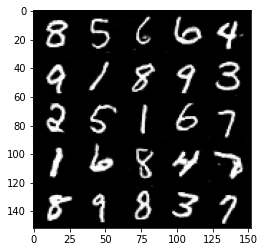

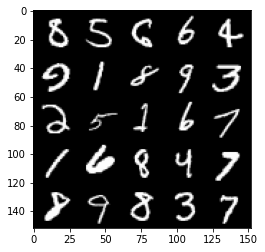

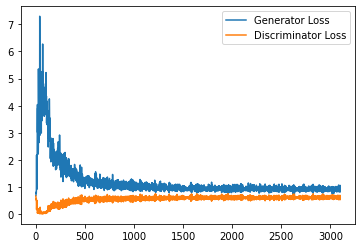

Step 62500: Generator loss: 0.9259756371974945, discriminator loss: 0.622762797653675


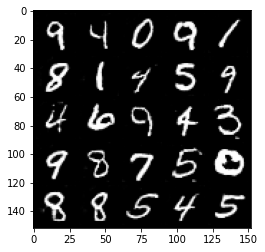

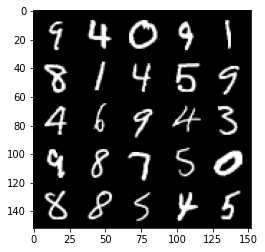

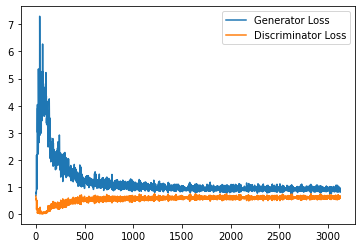

Step 63000: Generator loss: 0.9132631990909577, discriminator loss: 0.6215100219249725


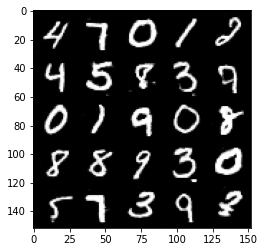

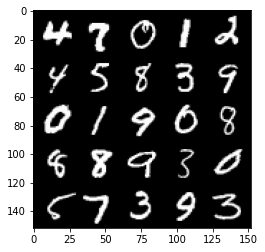

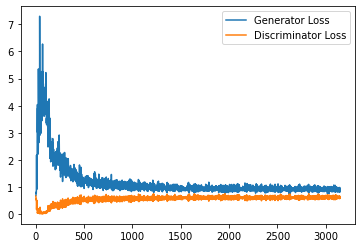

Step 63500: Generator loss: 0.9049013761281968, discriminator loss: 0.6244832820892334


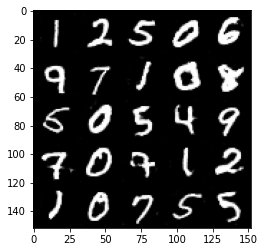

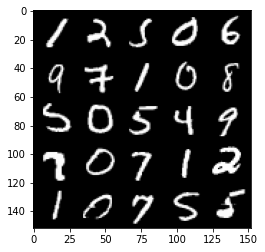

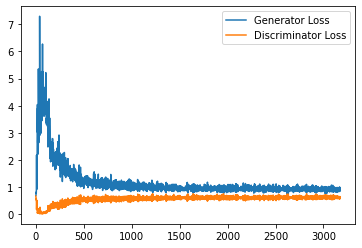

Step 64000: Generator loss: 0.9244412686824799, discriminator loss: 0.6206110247969627


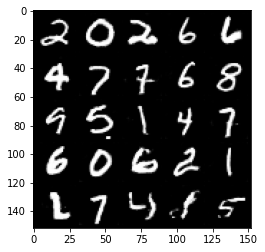

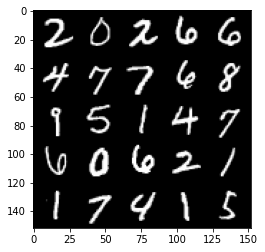

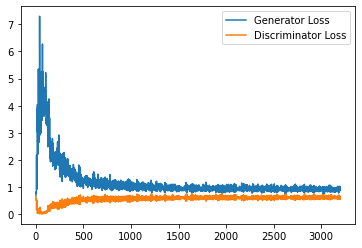

Step 64500: Generator loss: 0.9200486398935318, discriminator loss: 0.6275151009559632


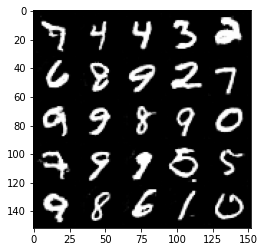

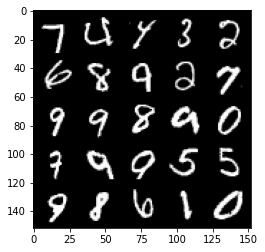

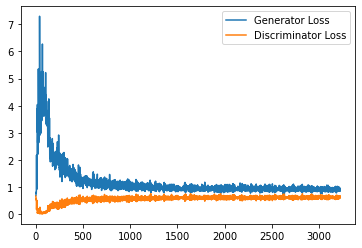

Step 65000: Generator loss: 0.9210170571804046, discriminator loss: 0.623031711935997


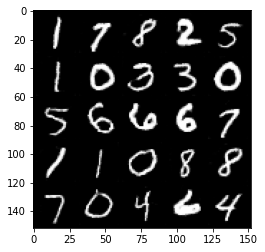

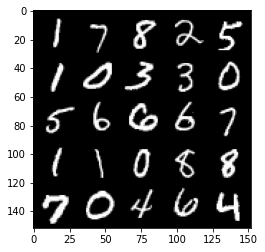

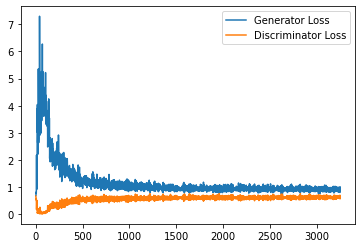

Step 65500: Generator loss: 0.9176999971866607, discriminator loss: 0.6223004813194275


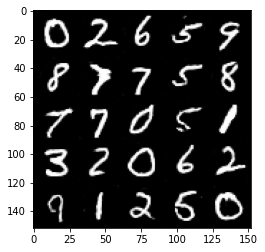

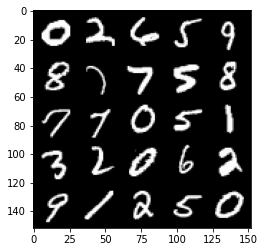

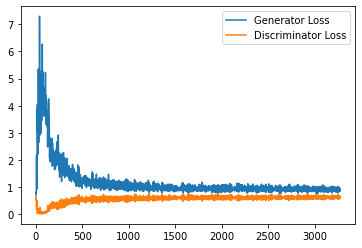

Step 66000: Generator loss: 0.9055494267940521, discriminator loss: 0.6246096537113189


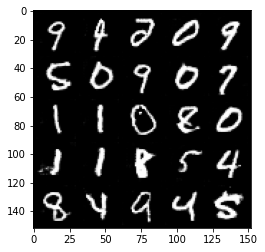

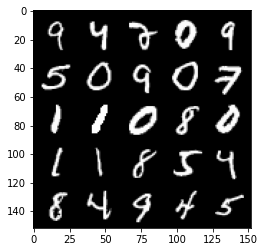

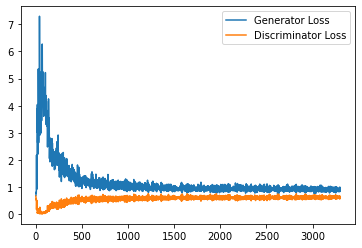

Step 66500: Generator loss: 0.9045937309265136, discriminator loss: 0.6252193725109101


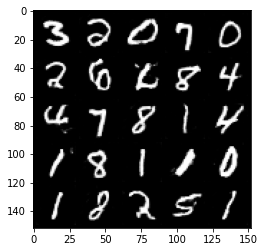

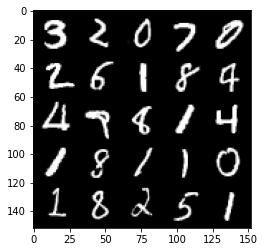

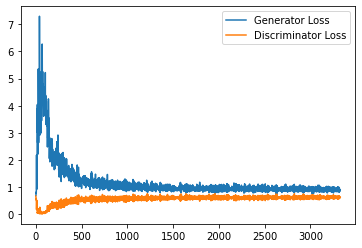

Step 67000: Generator loss: 0.9201055216789246, discriminator loss: 0.6242748943567276


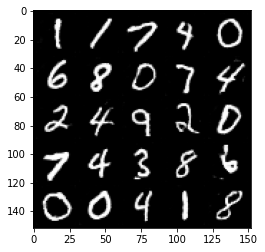

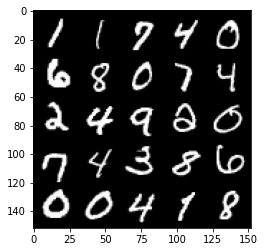

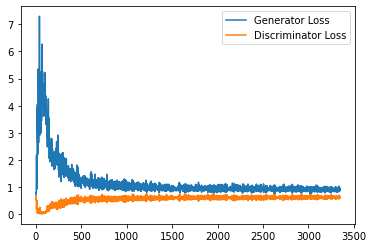

Step 67500: Generator loss: 0.9154494866132736, discriminator loss: 0.624380353152752


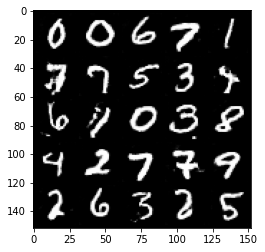

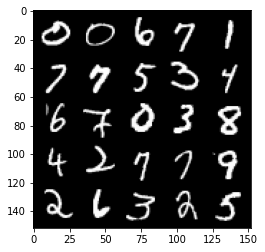

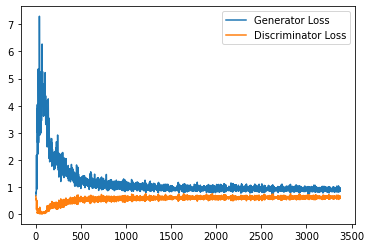

Step 68000: Generator loss: 0.9239971512556076, discriminator loss: 0.6228874301314354


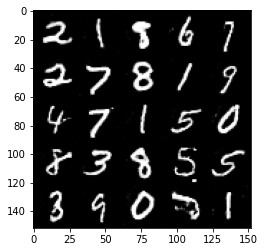

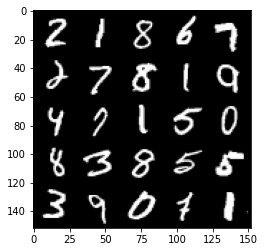

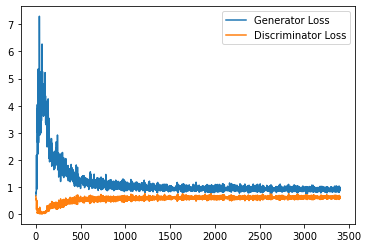

Step 68500: Generator loss: 0.9223677196502685, discriminator loss: 0.6271135646104813


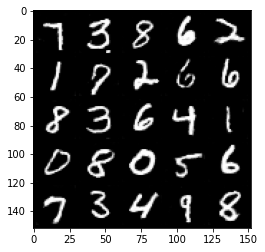

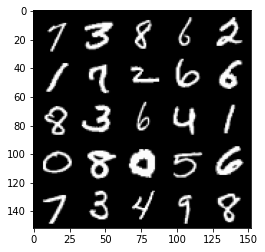

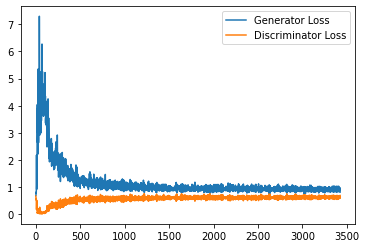

Step 69000: Generator loss: 0.9301742196083069, discriminator loss: 0.6237005104422569


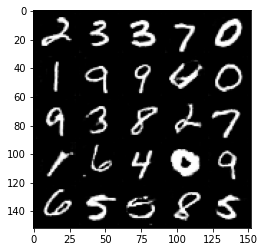

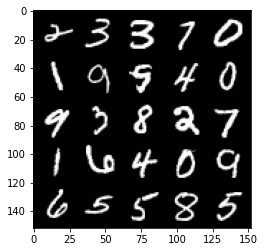

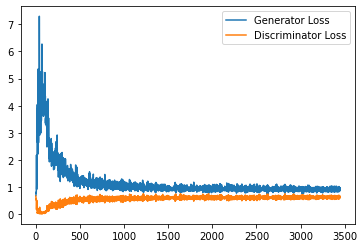

Step 69500: Generator loss: 0.9108131471872329, discriminator loss: 0.625031225323677


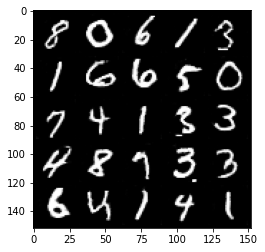

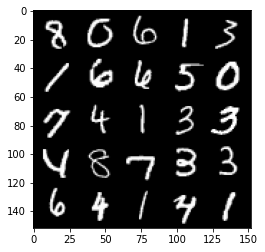

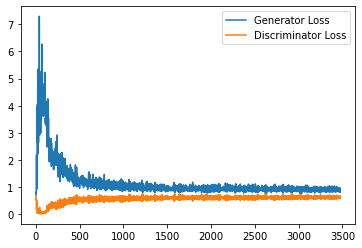

Step 70000: Generator loss: 0.906175276696682, discriminator loss: 0.6252551620006561


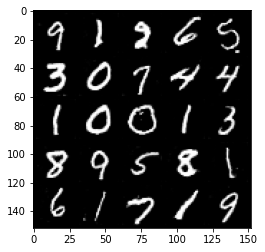

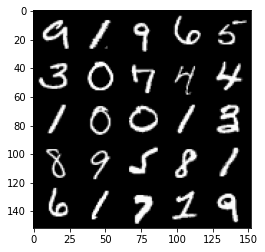

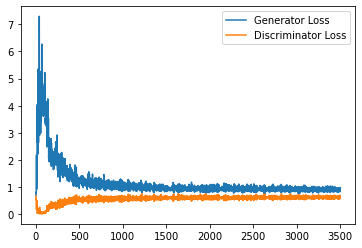

Step 70500: Generator loss: 0.9060467915534973, discriminator loss: 0.628570970594883


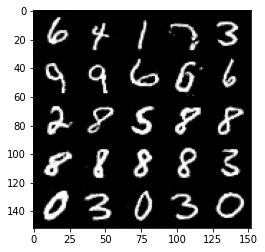

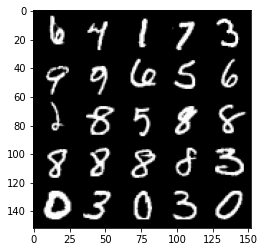

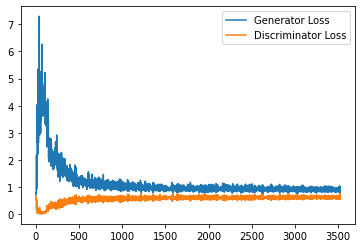

Step 71000: Generator loss: 0.9167346794605256, discriminator loss: 0.6218560748696327


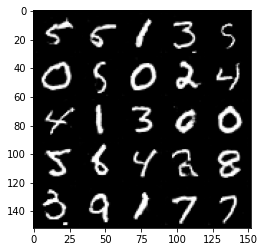

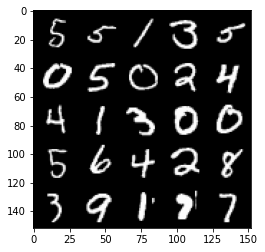

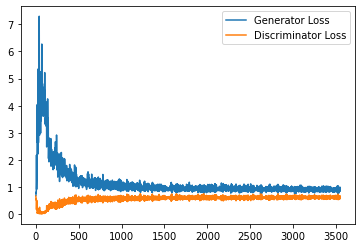

Step 71500: Generator loss: 0.9187352926731109, discriminator loss: 0.6255641984939575


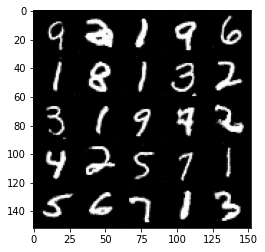

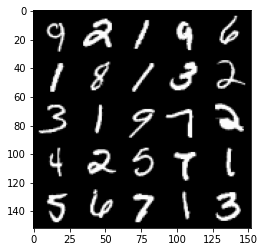

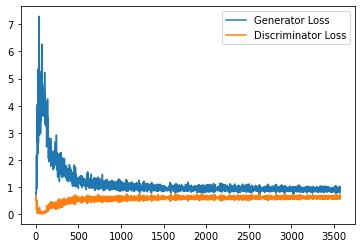

Step 72000: Generator loss: 0.9257366577386856, discriminator loss: 0.6263872756958008


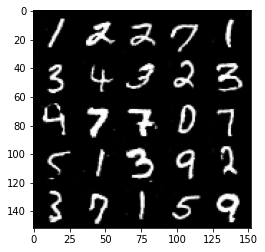

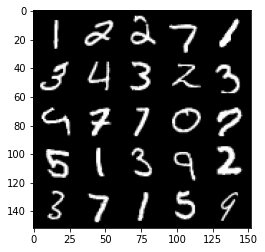

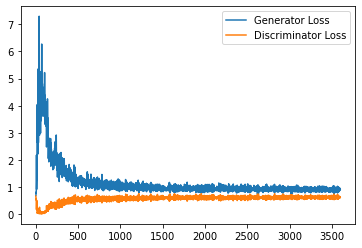

Step 72500: Generator loss: 0.9093656634092331, discriminator loss: 0.6274158775806427


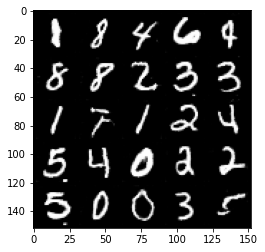

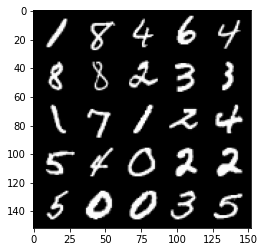

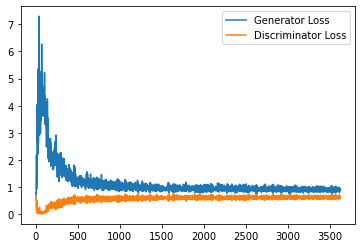

Step 73000: Generator loss: 0.9198348525762557, discriminator loss: 0.6223329939842224


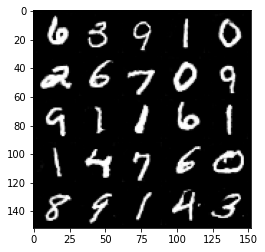

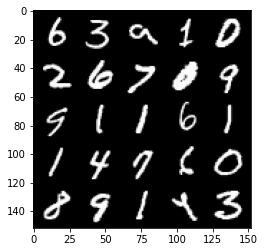

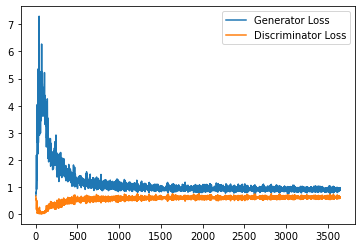

Step 73500: Generator loss: 0.9372187501192093, discriminator loss: 0.6265792799592018


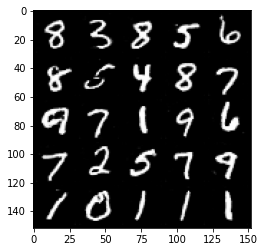

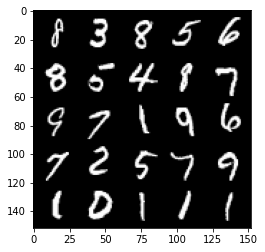

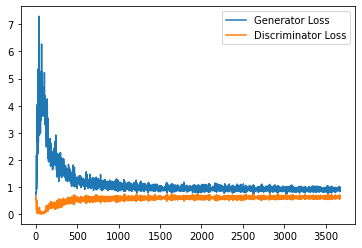

Step 74000: Generator loss: 0.9186105996370315, discriminator loss: 0.6256627609729767


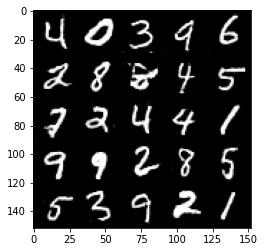

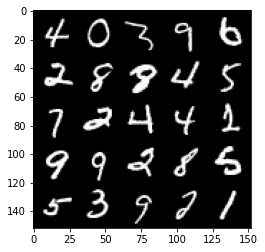

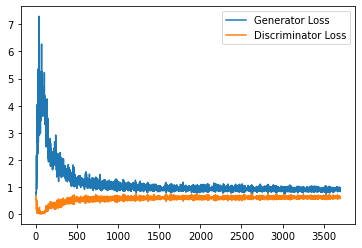

Step 74500: Generator loss: 0.9118818745613099, discriminator loss: 0.6287769218683242


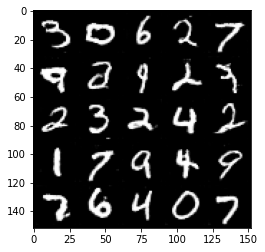

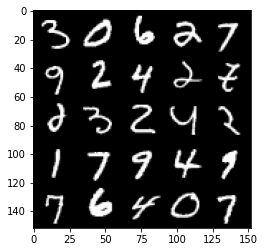

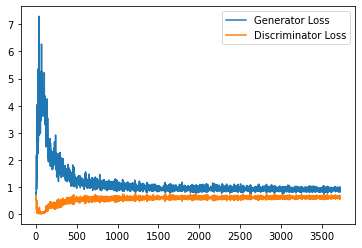

Step 75000: Generator loss: 0.923841145157814, discriminator loss: 0.6226846989989281


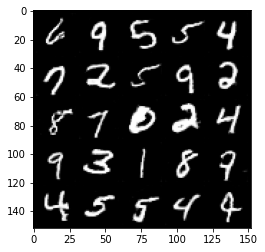

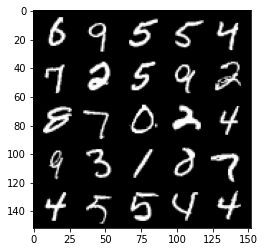

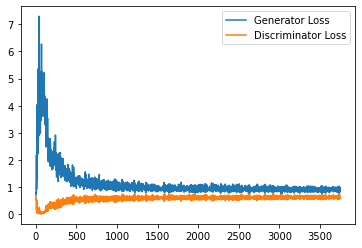

Step 75500: Generator loss: 0.9171288216114044, discriminator loss: 0.6247156422138214


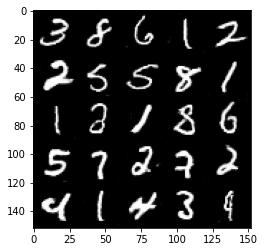

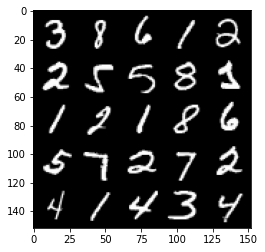

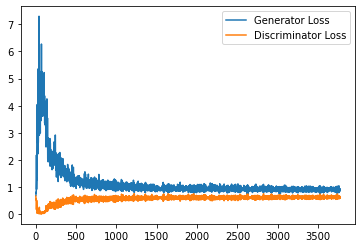

Step 76000: Generator loss: 0.9144126225709915, discriminator loss: 0.6252056694030762


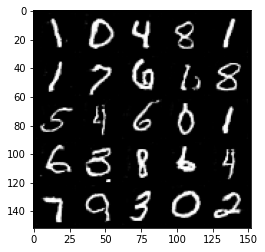

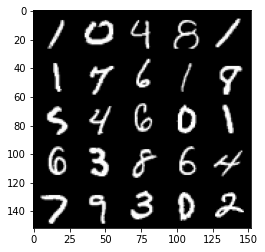

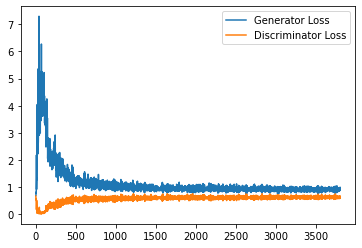

Step 76500: Generator loss: 0.9257460606098175, discriminator loss: 0.6249055697321891


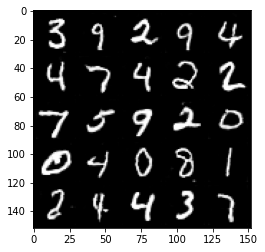

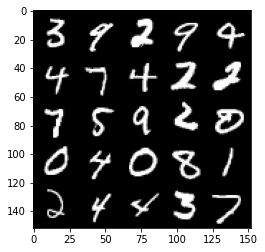

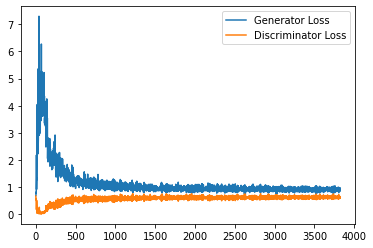

Step 77000: Generator loss: 0.9093053308725357, discriminator loss: 0.6264775056838989


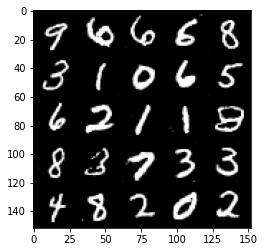

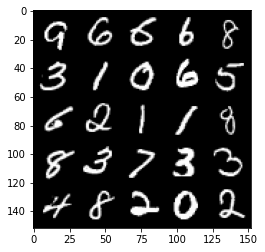

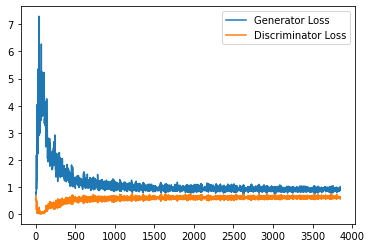

Step 77500: Generator loss: 0.9146355719566345, discriminator loss: 0.6292190454006195


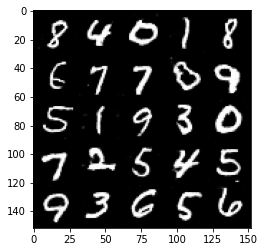

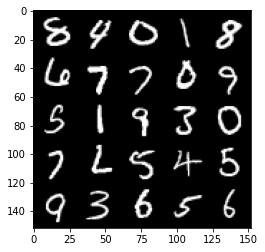

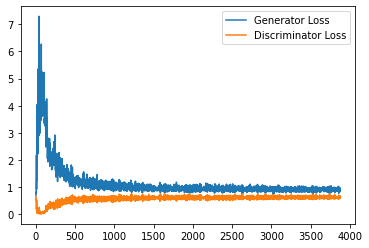

Step 78000: Generator loss: 0.9184319574832916, discriminator loss: 0.6305434457063674


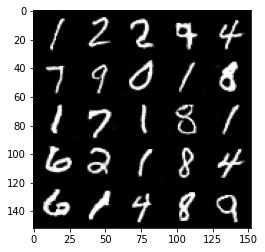

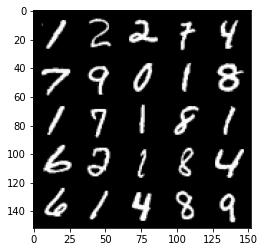

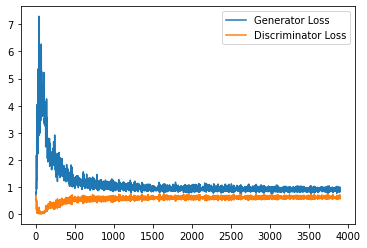

Step 78500: Generator loss: 0.9126819146871566, discriminator loss: 0.630230206489563


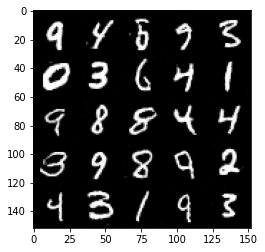

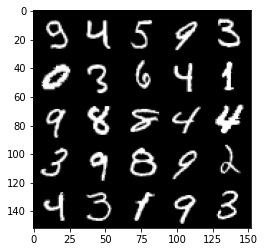

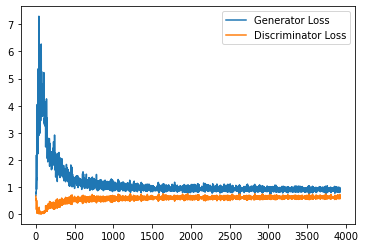

Step 79000: Generator loss: 0.9168554502725601, discriminator loss: 0.6242527451515197


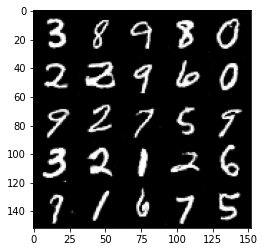

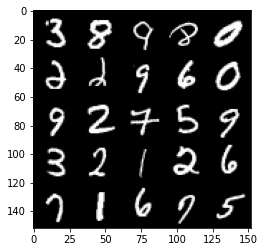

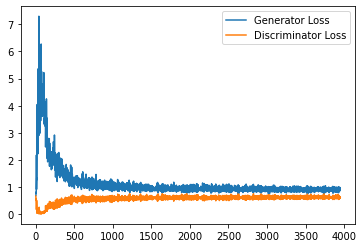

Step 79500: Generator loss: 0.9128101506233215, discriminator loss: 0.6329389830827713


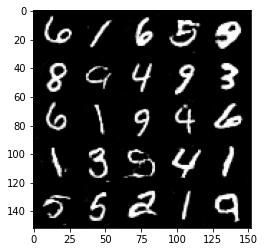

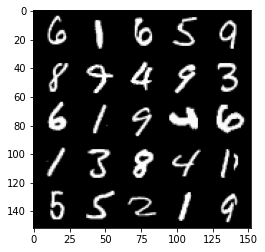

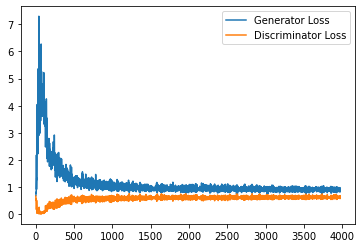

Step 80000: Generator loss: 0.916585924744606, discriminator loss: 0.627579315662384


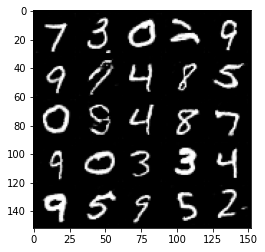

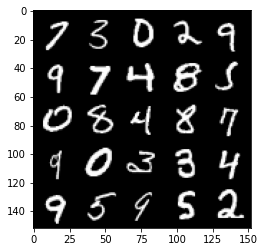

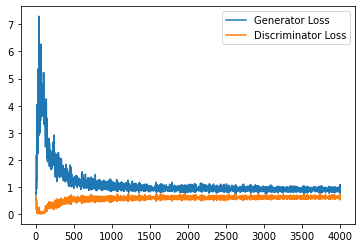

Step 80500: Generator loss: 0.9130577912330627, discriminator loss: 0.6256244345903397


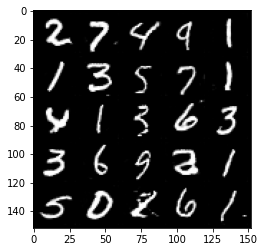

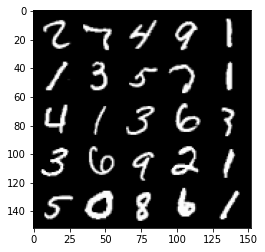

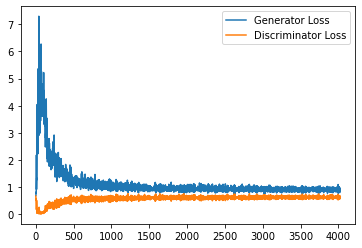

Step 81000: Generator loss: 0.89583915579319, discriminator loss: 0.6284378641843795


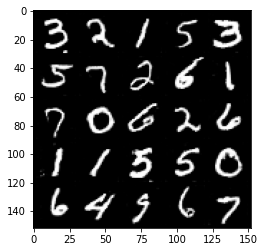

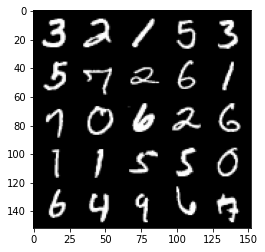

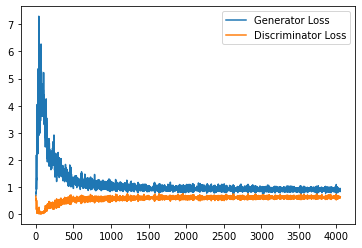

Step 81500: Generator loss: 0.9172810235023499, discriminator loss: 0.6263170322179794


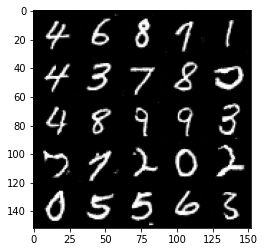

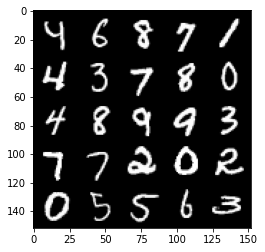

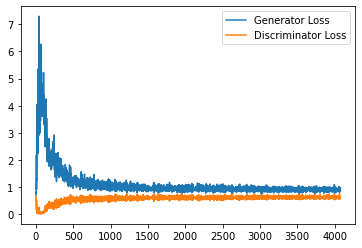

Step 82000: Generator loss: 0.9325324507951737, discriminator loss: 0.62678329372406


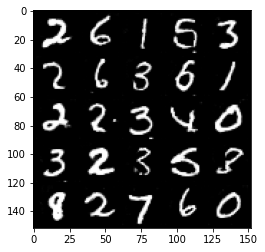

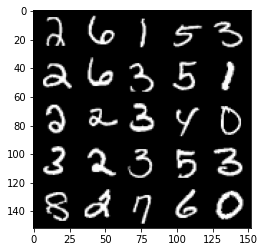

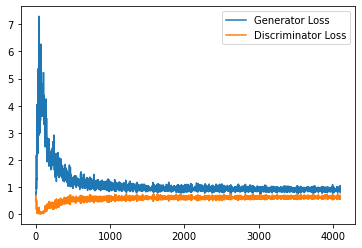

Step 82500: Generator loss: 0.9038490668535233, discriminator loss: 0.6268804540634155


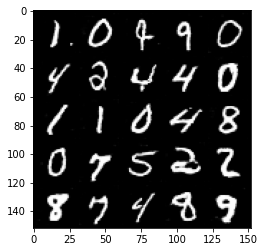

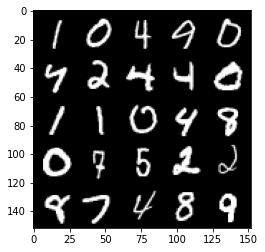

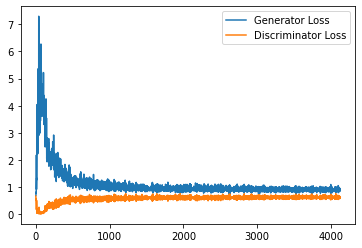

Step 83000: Generator loss: 0.9093760032653808, discriminator loss: 0.6289915409088135


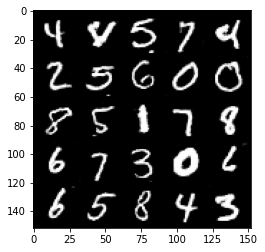

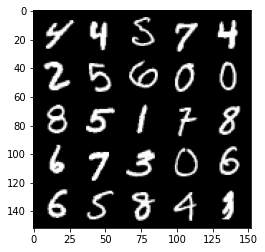

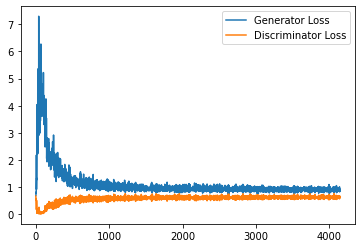

Step 83500: Generator loss: 0.9263590191602706, discriminator loss: 0.6254888362884522


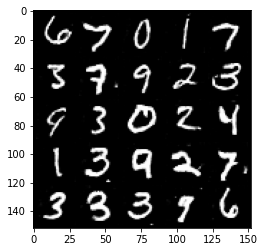

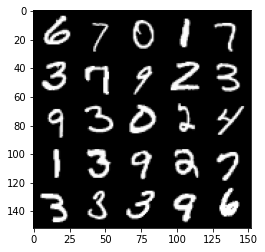

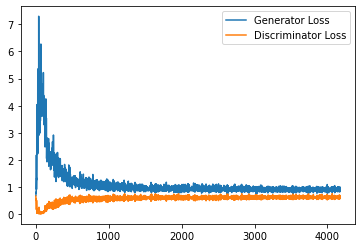

Step 84000: Generator loss: 0.9213291878700256, discriminator loss: 0.6328145211935043


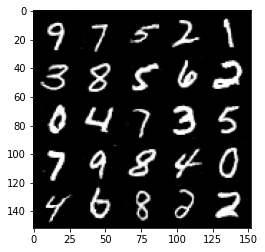

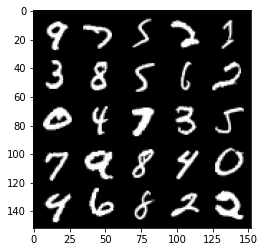

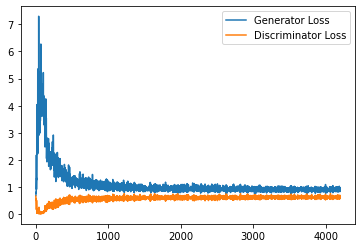

Step 84500: Generator loss: 0.9105594391822815, discriminator loss: 0.6278960449695588


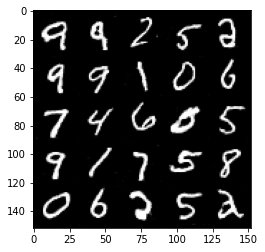

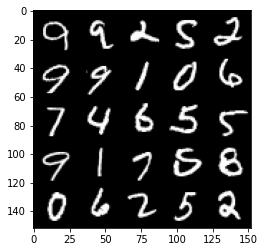

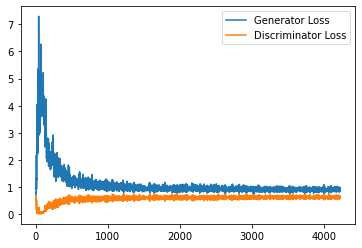

Step 85000: Generator loss: 0.9159191358089447, discriminator loss: 0.6239456642866135


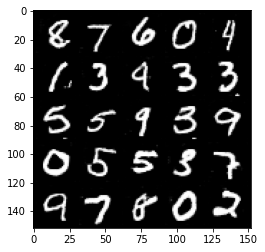

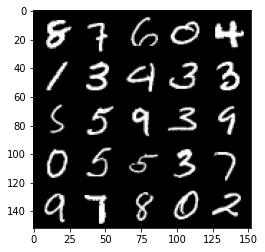

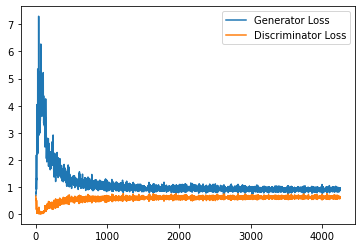

Step 85500: Generator loss: 0.9062610909938812, discriminator loss: 0.6256850576400756


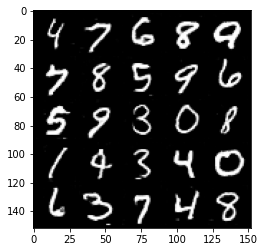

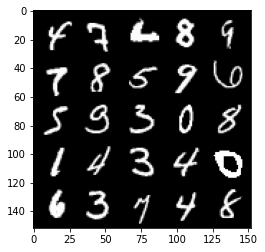

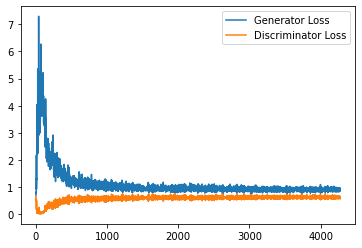

Step 86000: Generator loss: 0.9065457587242126, discriminator loss: 0.6299710174798966


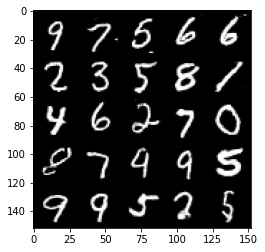

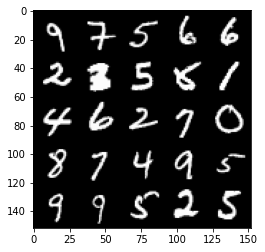

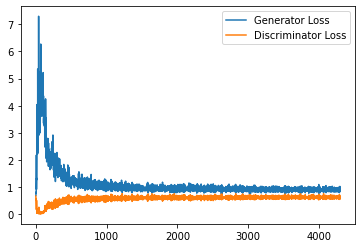

Step 86500: Generator loss: 0.9098565258979797, discriminator loss: 0.6313470901250839


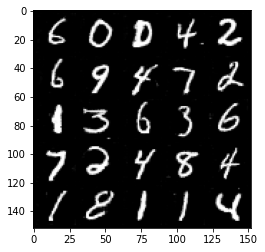

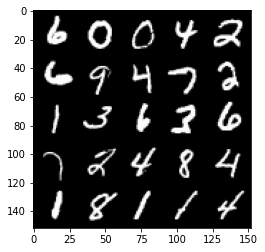

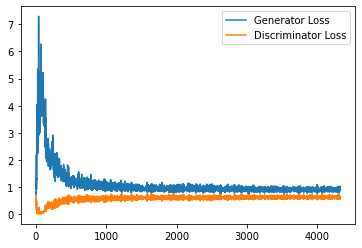

Step 87000: Generator loss: 0.9086490323543549, discriminator loss: 0.6310908209085464


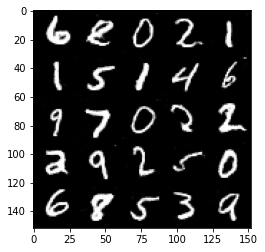

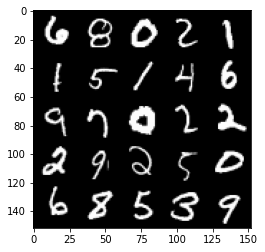

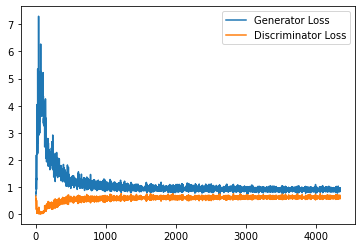

Step 87500: Generator loss: 0.9154416393041611, discriminator loss: 0.6279188679456711


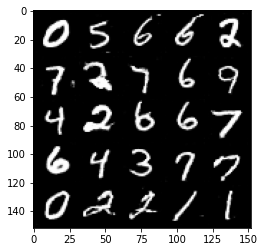

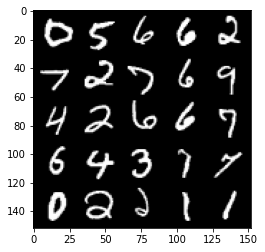

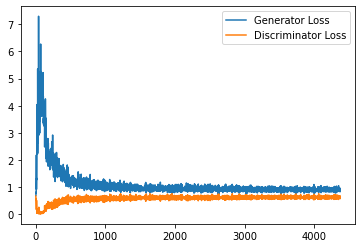

Step 88000: Generator loss: 0.9060510492324829, discriminator loss: 0.6280160719156265


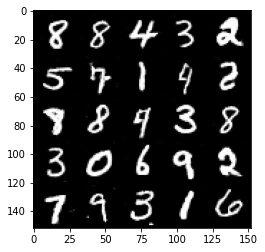

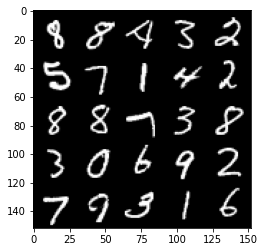

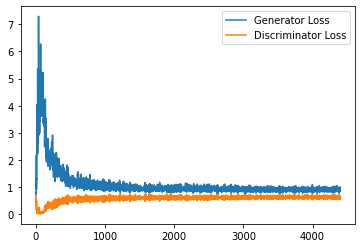

Step 88500: Generator loss: 0.8926612957715988, discriminator loss: 0.6347403396368027


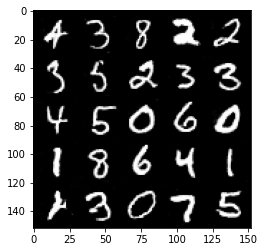

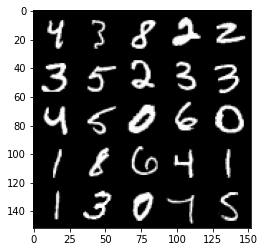

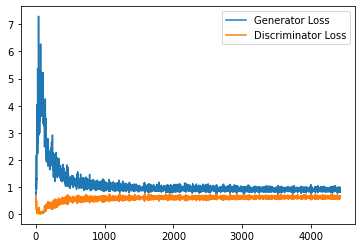

Step 89000: Generator loss: 0.9059312247037887, discriminator loss: 0.63136585521698


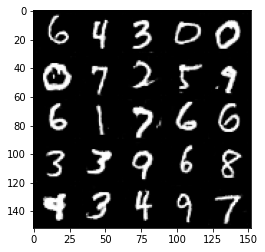

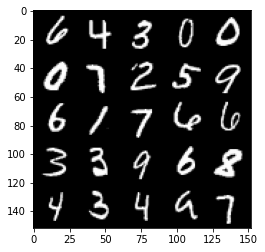

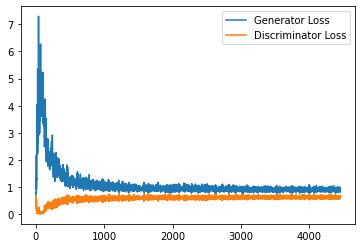

Step 89500: Generator loss: 0.9196665329933167, discriminator loss: 0.6272404968738556


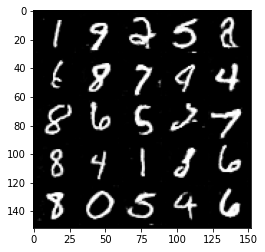

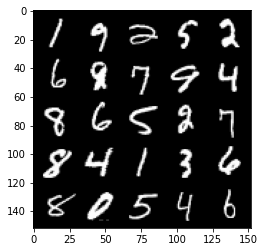

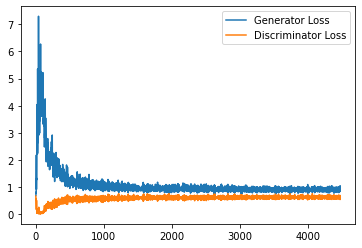

Step 90000: Generator loss: 0.9136998097896576, discriminator loss: 0.6312412123084068


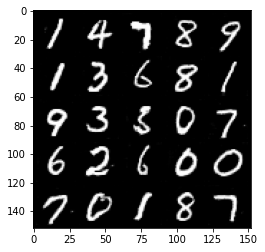

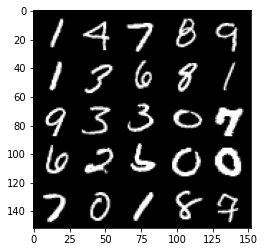

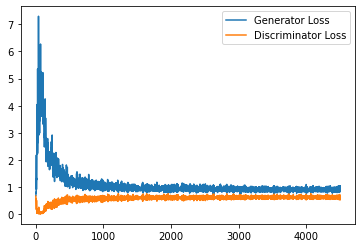

Step 90500: Generator loss: 0.9025199549198151, discriminator loss: 0.6317361104488373


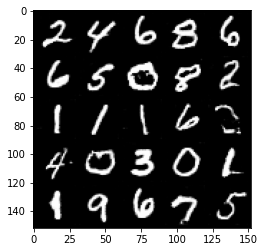

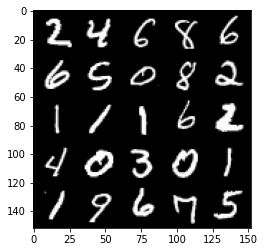

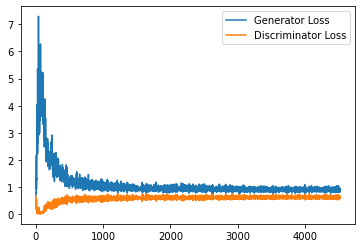

Step 91000: Generator loss: 0.8899075834751129, discriminator loss: 0.6348212161064148


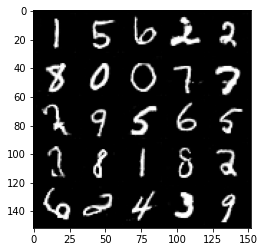

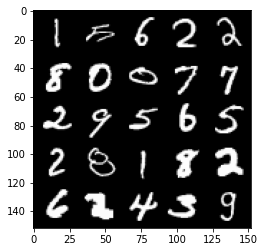

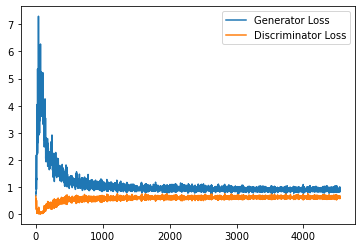

Step 91500: Generator loss: 0.9094186940193176, discriminator loss: 0.6309914476871491


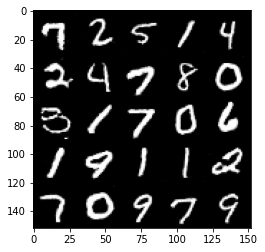

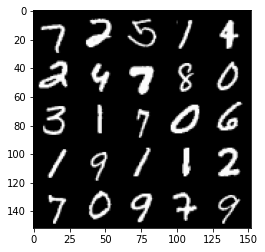

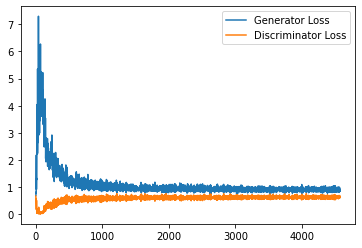

Step 92000: Generator loss: 0.9099768418073654, discriminator loss: 0.6290088074803353


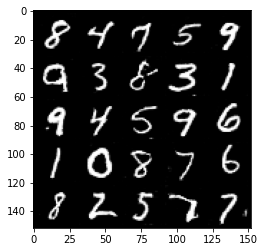

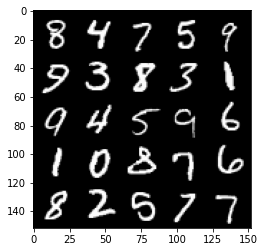

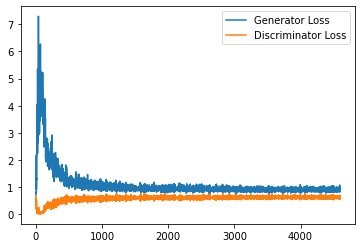

Step 92500: Generator loss: 0.9037388566732406, discriminator loss: 0.6305494864583016


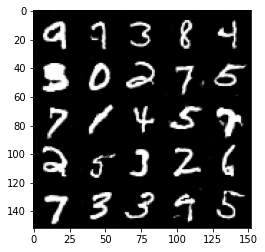

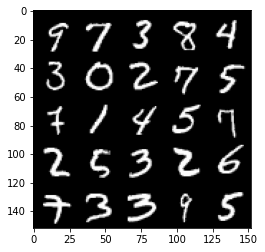

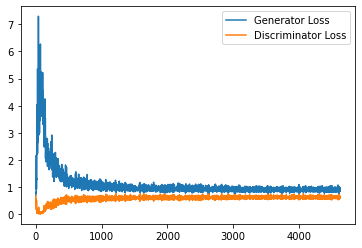

Step 93000: Generator loss: 0.9065343501567841, discriminator loss: 0.630135266661644


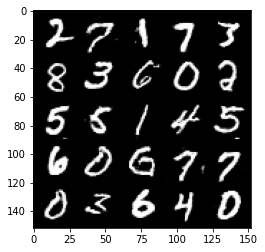

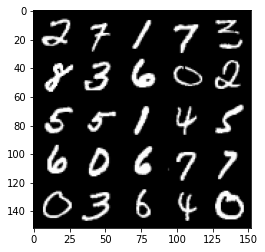

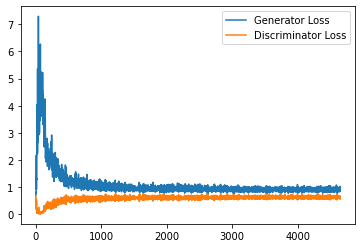

Step 93500: Generator loss: 0.9138530029058456, discriminator loss: 0.629352667927742


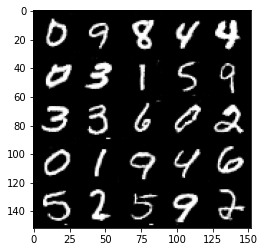

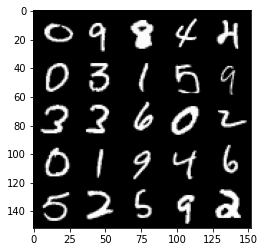

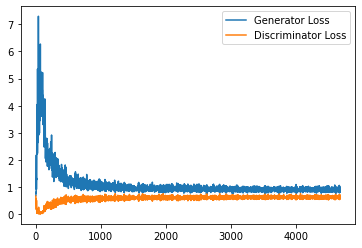

In [32]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [33]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

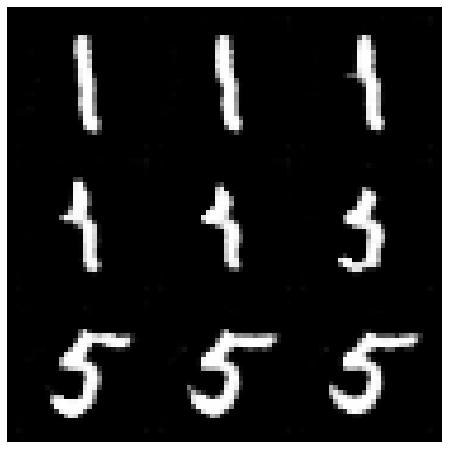

In [34]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

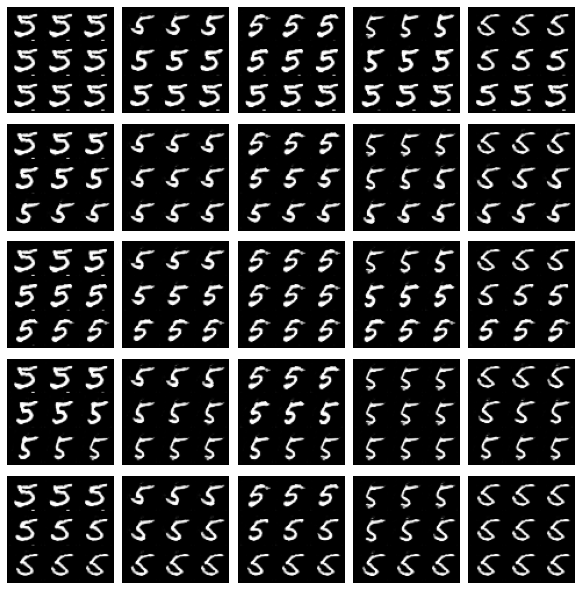

In [35]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()